# Problem Statement
This project aims to use generative adversarial networks (GANs) to create images in the style of Claude Monet, the renowned impressionist painter. The generated images will be evaluated on their artistic quality using the Memorization-informed Fréchet Inception Distance (MiFID) score, provided by Kaggle.

## Objective
Develop a GAN model capable of:
1. Generating Monet-style images based on the provided dataset of Monet paintings and landscape photos.
2. Optimizing the GAN model to minimize the MiFID score, ensuring high-quality image generation.


# Generative Adversarial Networks (GANs)
GANs are a class of generative models comprising two components:
- **Generator**: Creates synthetic data (images) from random noise.
- **Discriminator**: Distinguishes between real and generated images.

The interplay between these two networks enables the generator to improve over time, producing images indistinguishable from real ones.


# Evaluation Metric
The MiFID score incorporates:
- **Fréchet Inception Distance (FID)**: Measures similarity between the feature distributions of real and generated images.
- **Memorization Distance**: Evaluates the minimum cosine distance between generated images and real training samples.

A lower MiFID score indicates better quality and diversity of the generated images.


# Dataset Description
The dataset consists of four directories:
1. **monet_jpg**: 300 Monet paintings in JPEG format, size 256x256.
2. **photo_jpg**: 7028 photos in JPEG format, size 256x256.
3. **monet_tfrec**: TFRecord format of the Monet images.
4. **photo_tfrec**: TFRecord format of the photos.

All images are in RGB format, having three channels (Red, Green, Blue).

## Why Use TFRecords?
- **Efficient storage and access**: Optimized for large datasets.
- **Streamlined preprocessing pipeline**: Allows efficient batching, shuffling, and augmentation.
- **Better performance on distributed systems (e.g. TPUs)**

# Exploratory Data Analysis (EDA)

In [1]:
# Import necessary libraries
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import os
import random

In [2]:
# Functions to Load TFRecords for Monet paintings and photos
def decode_image(image):
    image = tf.image.decode_jpeg(image, channels=3)  # Decode JPEG
    image = tf.image.convert_image_dtype(image, tf.float32)  # Convert to float32
    image = tf.image.resize(image, [256, 256])  # Resize to 256x256
    return image

def read_tfrecord(example):
    feature_description = {
        "image_name": tf.io.FixedLenFeature([], tf.string),
        "image": tf.io.FixedLenFeature([], tf.string),
    }
    example = tf.io.parse_single_example(example, feature_description)
    image = decode_image(example["image"])
    return image

def load_tfrecord_dataset(filenames):
    return tf.data.TFRecordDataset(filenames).map(read_tfrecord, num_parallel_calls=tf.data.AUTOTUNE)

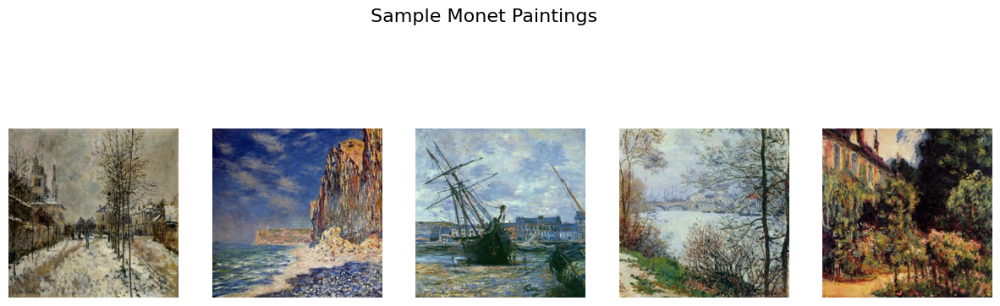

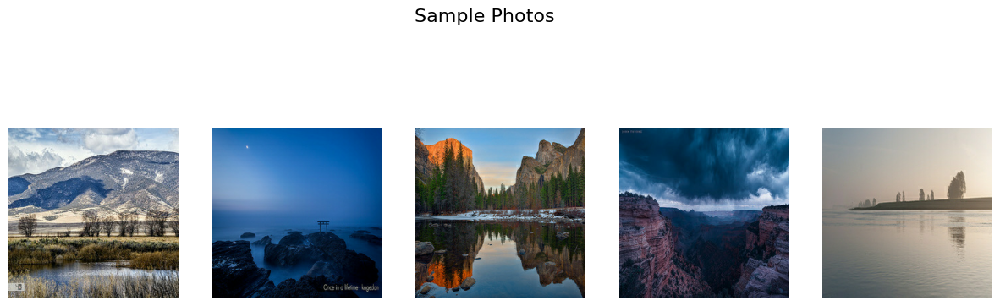

In [3]:
# File paths for TFRecords
monet_tfrecord_path = "/kaggle/input/gan-getting-started/monet_tfrec/*.tfrec"
photo_tfrecord_path = "/kaggle/input/gan-getting-started/photo_tfrec/*.tfrec"

monet_dataset = load_tfrecord_dataset(tf.io.gfile.glob(monet_tfrecord_path))
photo_dataset = load_tfrecord_dataset(tf.io.gfile.glob(photo_tfrecord_path))

# Visualize sample images with proper scaling
def visualize_images(dataset, title, num_images=5):
    plt.figure(figsize=(15, 5))
    for i, image in enumerate(dataset.take(num_images)):
        image = image.numpy()  # Convert to NumPy array
        image = (image * 255).astype(np.uint8)  # Scale [0, 1] to [0, 255] and convert to uint8
        plt.subplot(1, num_images, i + 1)
        plt.imshow(image)  # Display the image
        plt.axis('off')
    plt.suptitle(title, fontsize=16)
    plt.show()

# Visualize Monet and photo samples
visualize_images(monet_dataset, "Sample Monet Paintings", num_images=5)
visualize_images(photo_dataset, "Sample Photos", num_images=5)

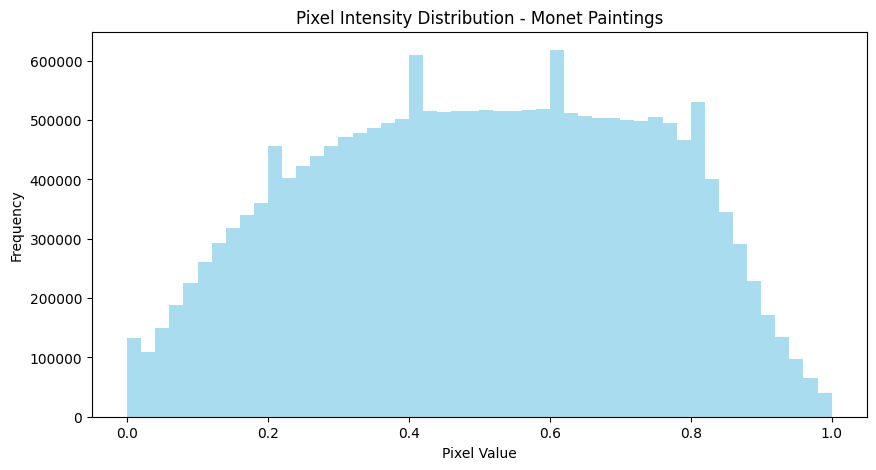

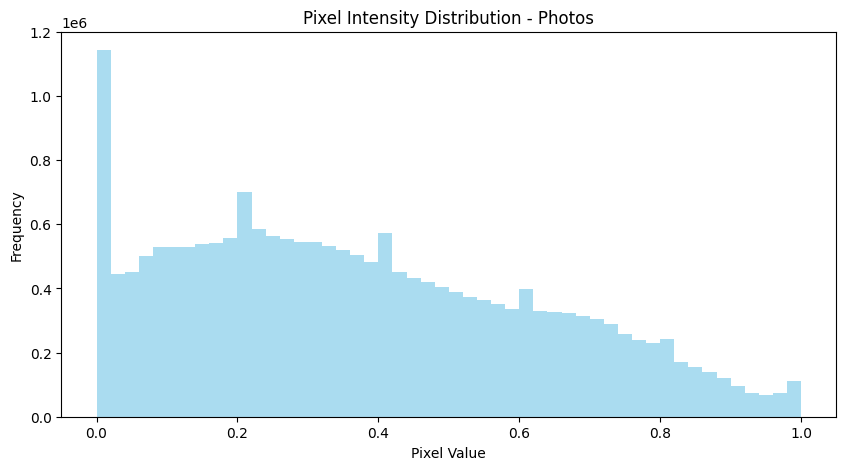

In [4]:
# Analyze pixel intensity distributions
def plot_pixel_intensity(dataset, title, num_images=100):
    pixel_values = []
    for image in dataset.take(num_images):
        pixel_values.append(image.numpy().flatten())
    pixel_values = np.concatenate(pixel_values)
    plt.figure(figsize=(10, 5))
    plt.hist(pixel_values, bins=50, color='skyblue', alpha=0.7)
    plt.title(f"Pixel Intensity Distribution - {title}")
    plt.xlabel("Pixel Value")
    plt.ylabel("Frequency")
    plt.show()

plot_pixel_intensity(monet_dataset, "Monet Paintings")
plot_pixel_intensity(photo_dataset, "Photos")

# Model Architecture

## Generative Adversarial Network (GAN)
A GAN consists of two neural networks that compete against each other:
- **Generator**: Creates fake images to resemble the Monet paintings.
- **Discriminator**: Distinguishes between real Monet paintings and fake (generated) images.

The goal of this competition is for the generator to produce images so realistic that the discriminator can no longer differentiate between real and fake.

## CycleGAN Overview
For this project, we will use **CycleGAN**, a specific GAN variant designed for unpaired image-to-image translation. This is useful because we only have two datasets (Monet paintings and photos) but no exact pairings between the two.

### Components of CycleGAN
1. **Generators**:
   - `G: Photos -> Monet-style images`
   - `F: Monet-style images -> Photos`
2. **Discriminators**:
   - `D_M`: Discriminates real Monet images from generated Monet-style images.
   - `D_P`: Discriminates real photos from generated photos.

### CycleGAN Loss Functions
1. **Adversarial Loss**:
   Ensures the generated images are indistinguishable from real images.
   
2. **Cycle Consistency Loss**:
   Ensures that translating an image to the other domain and back produces the original image.

3. **Identity Loss**:
   Preserves the color composition of the input photo when generating Monet-style images.


## Architecture Design
We use the following architecture for the generator and discriminator:

### Generator:
- Uses **ResNet blocks** for preserving image details.
- Includes upsampling layers to improve the resolution of generated images.

### Discriminator:
- A **PatchGAN** classifier is used to evaluate image patches rather than the entire image, ensuring finer discrimination of texture and style.eGAN architecture using TensorFlow/Keras.


In [5]:
from tensorflow.keras import layers

# Define the ResNet block for the generator
def resnet_block(input_tensor, filters):
    x = layers.Conv2D(filters, kernel_size=3, strides=1, padding="same")(input_tensor)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    x = layers.Conv2D(filters, kernel_size=3, strides=1, padding="same")(x)
    x = layers.BatchNormalization()(x)
    x = layers.add([input_tensor, x])  # Skip connection
    return x

# Define the generator
def build_generator():
    inputs = layers.Input(shape=[256, 256, 3])
    
    # Downsampling
    x = layers.Conv2D(64, kernel_size=7, strides=1, padding="same")(inputs)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    
    x = layers.Conv2D(128, kernel_size=3, strides=2, padding="same")(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    
    x = layers.Conv2D(256, kernel_size=3, strides=2, padding="same")(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    
    # ResNet blocks
    for _ in range(9):
        x = resnet_block(x, 256)
    
    # Upsampling
    x = layers.Conv2DTranspose(128, kernel_size=3, strides=2, padding="same")(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    
    x = layers.Conv2DTranspose(64, kernel_size=3, strides=2, padding="same")(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    
    x = layers.Conv2D(3, kernel_size=7, strides=1, padding="same", activation="tanh")(x)
    
    return tf.keras.Model(inputs, x)

# Define the PatchGAN discriminator
def build_discriminator():
    inputs = layers.Input(shape=[256, 256, 3])
    
    x = layers.Conv2D(64, kernel_size=4, strides=2, padding="same")(inputs)
    x = layers.LeakyReLU(0.2)(x)
    
    x = layers.Conv2D(128, kernel_size=4, strides=2, padding="same")(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(0.2)(x)
    
    x = layers.Conv2D(256, kernel_size=4, strides=2, padding="same")(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(0.2)(x)
    
    x = layers.Conv2D(512, kernel_size=4, strides=1, padding="same")(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(0.2)(x)
    
    x = layers.Conv2D(1, kernel_size=4, strides=1, padding="same")(x)
    
    return tf.keras.Model(inputs, x)

# Build the generators and discriminators
generator_G = build_generator()  # Photos -> Monet
generator_F = build_generator()  # Monet -> Photos
discriminator_M = build_discriminator()  # Monet discriminator
discriminator_P = build_discriminator()  # Photo discriminator

# Print model summaries
generator_G.summary()
discriminator_M.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 256, 256,  │      9,472 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 256, 256,  │        256 │ conv2d[0][0]      │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu (ReLU)        │ (None, 256, 256,  │          0 │ batch_normalizat… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 128, 128,  │     73,856 │ re_lu[0][0]       │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 128, 128,  │        512 │ conv2d_1[0][0]    │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_1 (ReLU)      │ (None, 128, 128,  │          0 │ batch_normalizat… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 64, 64,    │    295,168 │ re_lu_1[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │      1,024 │ conv2d_2[0][0]    │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_2 (ReLU)      │ (None, 64, 64,    │          0 │ batch_normalizat… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 64, 64,    │    590,080 │ re_lu_2[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │      1,024 │ conv2d_3[0][0]    │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_3 (ReLU)      │ (None, 64, 64,    │          0 │ batch_normalizat… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 64, 64,    │    590,080 │ re_lu_3[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │      1,024 │ conv2d_4[0][0]    │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add (Add)           │ (None, 64, 64,    │          0 │ re_lu_2[0][0],    │
│                     │ 256)              │            │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_5 (Conv2D)   │ (None, 64, 64,    │    590,080 │ add[0][0]       

 Total params: 11,399,171 (43.48 MB)

 Trainable params: 11,388,675 (43.44 MB)

 Non-trainable params: 10,496 (41.00 KB)

Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_2 (InputLayer)      │ (None, 256, 256, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_44 (Conv2D)              │ (None, 128, 128, 64)   │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 128, 128, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_45 (Conv2D)              │ (None, 64, 64, 128)    │       131,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_46          │ (None, 64, 64, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 64, 64, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_46 (Conv2D)              │ (None, 32, 32, 256)    │       524,544 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_47          │ (None, 32, 32, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 32, 32, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_47 (Conv2D)              │ (None, 32, 32, 512)    │     2,097,664 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_48          │ (None, 32, 32, 512)    │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_3 (LeakyReLU)       │ (None, 32, 32, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_48 (Conv2D)              │ (None, 32, 32, 1)      │         8,193 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,768,321 (10.56 MB)

 Trainable params: 2,766,529 (10.55 MB)

 Non-trainable params: 1,792 (7.00 KB)

# Training Procedure and Loss Functions

## Loss Functions

Training a CycleGAN involves multiple loss functions to ensure realistic image generation and consistency across domains.

### 1. Adversarial Loss
The adversarial loss helps the generator produce images indistinguishable from real ones.

- **Generator Loss**:
  - Encourages the generator to produce images that fool the discriminator.
  - Defined as the binary cross-entropy loss between the discriminator's predictions and "real" labels.

- **Discriminator Loss**:
  - Encourages the discriminator to distinguish between real and fake images.
  - Computed as the sum of the loss for real images and generated images.

### 2. Cycle Consistency Loss
Ensures that translating an image to the other domain and back results in the original image:
- Cycle loss for `Photo → Monet → Photo`.
- Cycle loss for `Monet → Photo → Monet`.

The loss is computed as the mean absolute error (MAE) between the input image and the reconstructed image.

### 3. Identity Loss
Preserves the color composition of the input image when translating it to the same domain.
- For example, a photo translated into the "photo domain" should remain unchanged.


## Training Procedure

### Optimizers
- Using the Adam optimizer with:
  - Learning rate: 0.0002
  - Beta values: (0.5, 0.999)

### Training Steps
1. **Discriminator Training**:
   - Train `D_M` and `D_P` (Monet and photo discriminators) to classify real vs. fake images.
2. **Generator Training**:
   - Train `G` and `F` (photo → Monet and Monet → photo generators) using:
     - Adversarial loss
     - Cycle consistency loss
     - Identity loss
3. Alternate between discriminator and generator updates for stability.


## Implementation
Below is the implementation o the training step, including the loss functions. the training step, including the loss functions.


In [11]:
# Define loss functions
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, fake_output):
    real_loss = loss_object(tf.ones_like(real_output), real_output)  # Real labeled as 1
    fake_loss = loss_object(tf.zeros_like(fake_output), fake_output)  # Fake labeled as 0
    return (real_loss + fake_loss) * 0.5

def generator_loss(fake_output):
    return loss_object(tf.ones_like(fake_output), fake_output)  # Fake labeled as real

def cycle_consistency_loss(real_image, cycled_image):
    return tf.reduce_mean(tf.abs(real_image - cycled_image))

def identity_loss(real_image, same_image):
    return tf.reduce_mean(tf.abs(real_image - same_image))

# Define optimizers
generator_g_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)
discriminator_m_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)
discriminator_p_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)

# Define training step
@tf.function
def train_step(real_photo, real_monet):
    with tf.GradientTape(persistent=True) as tape:
        # Generate fake images
        fake_monet = generator_G(real_photo, training=True)
        fake_photo = generator_F(real_monet, training=True)
        
        # Reconstruct original images
        cycled_photo = generator_F(fake_monet, training=True)
        cycled_monet = generator_G(fake_photo, training=True)
        
        # Identity mapping
        same_photo = generator_F(real_photo, training=True)
        same_monet = generator_G(real_monet, training=True)
        
        # Discriminator predictions
        disc_real_monet = discriminator_M(real_monet, training=True)
        disc_fake_monet = discriminator_M(fake_monet, training=True)
        disc_real_photo = discriminator_P(real_photo, training=True)
        disc_fake_photo = discriminator_P(fake_photo, training=True)
        
        # Compute losses
        gen_g_loss = generator_loss(disc_fake_monet)
        gen_f_loss = generator_loss(disc_fake_photo)
        cycle_loss = cycle_consistency_loss(real_photo, cycled_photo) + cycle_consistency_loss(real_monet, cycled_monet)
        identity_loss_value = identity_loss(real_photo, same_photo) + identity_loss(real_monet, same_monet)
        
        total_gen_g_loss = gen_g_loss + cycle_loss * CYCLE_LOSS_WEIGHT + identity_loss_value * IDENTITY_LOSS_WEIGHT
        total_gen_f_loss = gen_f_loss + cycle_loss * CYCLE_LOSS_WEIGHT + identity_loss_value * IDENTITY_LOSS_WEIGHT
        
        disc_m_loss = discriminator_loss(disc_real_monet, disc_fake_monet)
        disc_p_loss = discriminator_loss(disc_real_photo, disc_fake_photo)
    
    # Compute gradients
    generator_g_gradients = tape.gradient(total_gen_g_loss, generator_G.trainable_variables)
    generator_f_gradients = tape.gradient(total_gen_f_loss, generator_F.trainable_variables)
    discriminator_m_gradients = tape.gradient(disc_m_loss, discriminator_M.trainable_variables)
    discriminator_p_gradients = tape.gradient(disc_p_loss, discriminator_P.trainable_variables)
    
    # Apply gradients
    generator_g_optimizer.apply_gradients(zip(generator_g_gradients, generator_G.trainable_variables))
    generator_f_optimizer.apply_gradients(zip(generator_f_gradients, generator_F.trainable_variables))
    discriminator_m_optimizer.apply_gradients(zip(discriminator_m_gradients, discriminator_M.trainable_variables))
    discriminator_p_optimizer.apply_gradients(zip(discriminator_p_gradients, discriminator_P.trainable_variables))
    
    # Return all losses for logging
    return {
        "gen_g_loss": total_gen_g_loss,
        "gen_f_loss": total_gen_f_loss,
        "disc_m_loss": disc_m_loss,
        "disc_p_loss": disc_p_loss,
        "cycle_loss": cycle_loss,
        "identity_loss": identity_loss_value,
    }

Epoch 1/20
Time for epoch 1: 181.79 seconds
Generator G Loss: 6.3859
Generator F Loss: 6.3151
Discriminator Monet Loss: 0.6044
Discriminator Photo Loss: 0.6336
Cycle Consistency Loss: 0.3666
Identity Loss: 0.3481
Generated images after 1 epochs:


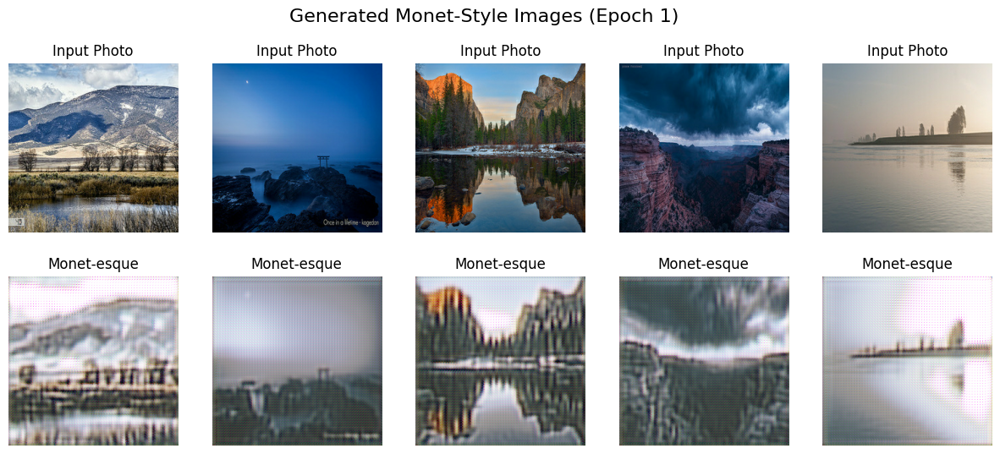

Epoch 2/20
Time for epoch 2: 127.92 seconds
Generator G Loss: 6.2794
Generator F Loss: 6.2859
Discriminator Monet Loss: 0.5117
Discriminator Photo Loss: 0.4885
Cycle Consistency Loss: 0.3339
Identity Loss: 0.3280
Generated images after 2 epochs:


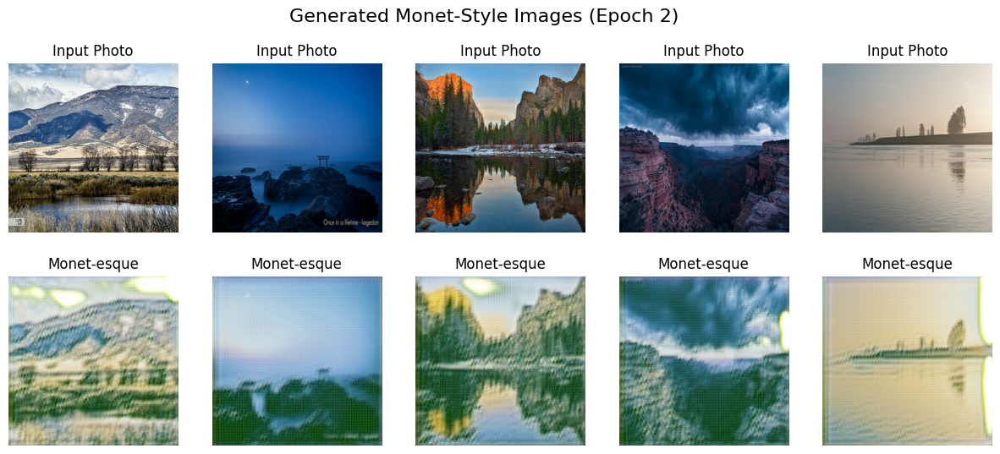

Epoch 3/20
Time for epoch 3: 127.92 seconds
Generator G Loss: 6.0031
Generator F Loss: 6.0000
Discriminator Monet Loss: 0.5207
Discriminator Photo Loss: 0.5364
Cycle Consistency Loss: 0.3190
Identity Loss: 0.3132
Generated images after 3 epochs:


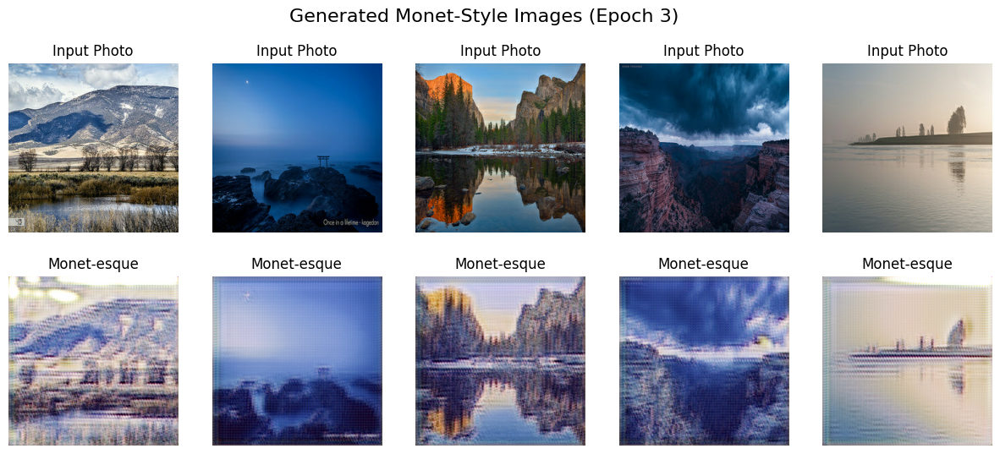

Epoch 4/20
Time for epoch 4: 127.87 seconds
Generator G Loss: 6.0092
Generator F Loss: 5.7805
Discriminator Monet Loss: 0.4937
Discriminator Photo Loss: 0.5508
Cycle Consistency Loss: 0.3113
Identity Loss: 0.3036
Generated images after 4 epochs:


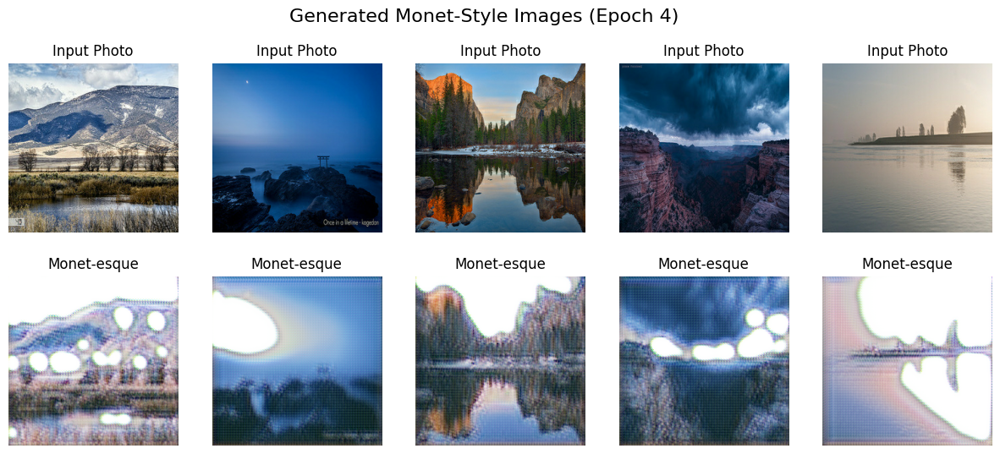

Epoch 5/20
Time for epoch 5: 127.71 seconds
Generator G Loss: 5.9875
Generator F Loss: 5.6528
Discriminator Monet Loss: 0.4707
Discriminator Photo Loss: 0.5635
Cycle Consistency Loss: 0.3052
Identity Loss: 0.2991
Generated images after 5 epochs:


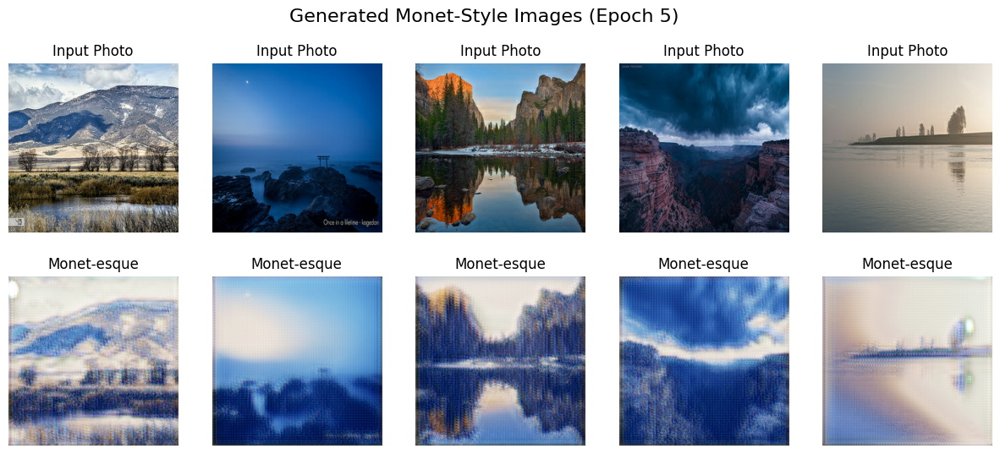

Epoch 6/20
Time for epoch 6: 127.80 seconds
Generator G Loss: 6.0193
Generator F Loss: 5.6026
Discriminator Monet Loss: 0.4550
Discriminator Photo Loss: 0.5510
Cycle Consistency Loss: 0.2992
Identity Loss: 0.2956
Generated images after 6 epochs:


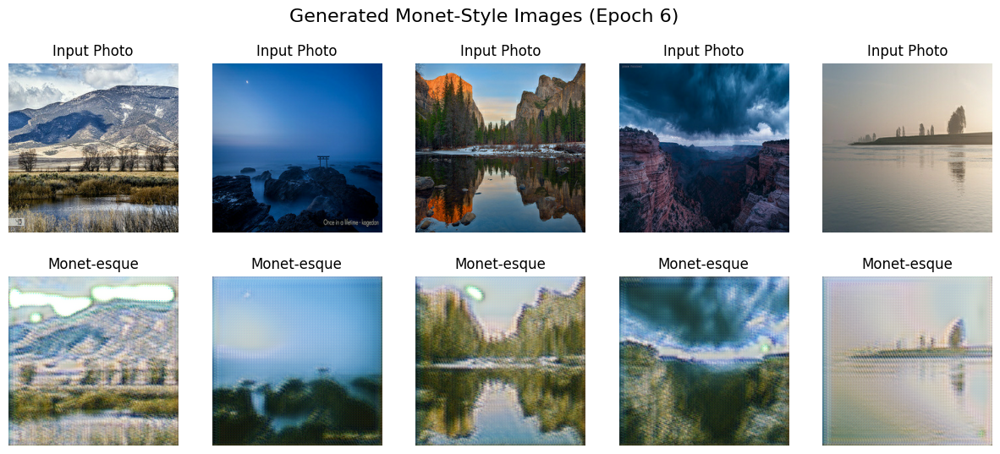

Epoch 7/20
Time for epoch 7: 127.74 seconds
Generator G Loss: 6.6061
Generator F Loss: 6.1033
Discriminator Monet Loss: 0.4142
Discriminator Photo Loss: 0.5133
Cycle Consistency Loss: 0.3283
Identity Loss: 0.3152
Generated images after 7 epochs:


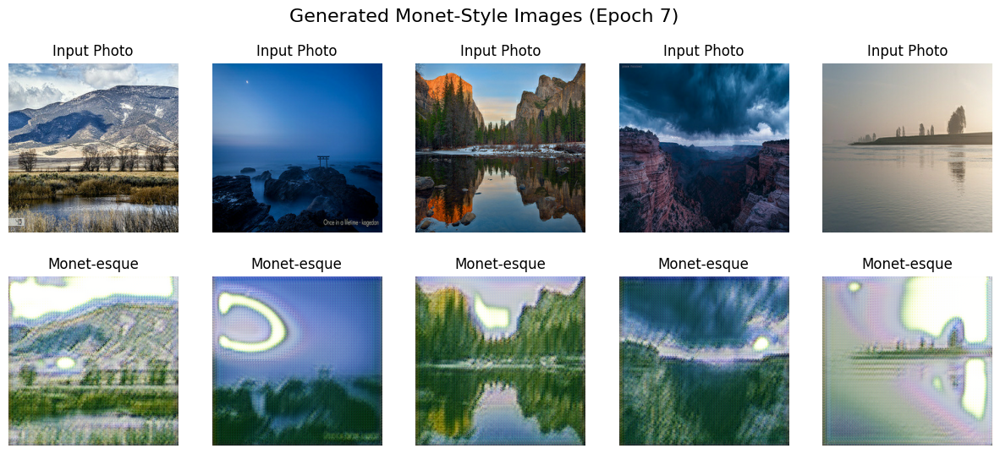

Epoch 8/20
Time for epoch 8: 127.76 seconds
Generator G Loss: 5.9260
Generator F Loss: 5.4689
Discriminator Monet Loss: 0.4366
Discriminator Photo Loss: 0.5406
Cycle Consistency Loss: 0.2856
Identity Loss: 0.2824
Generated images after 8 epochs:


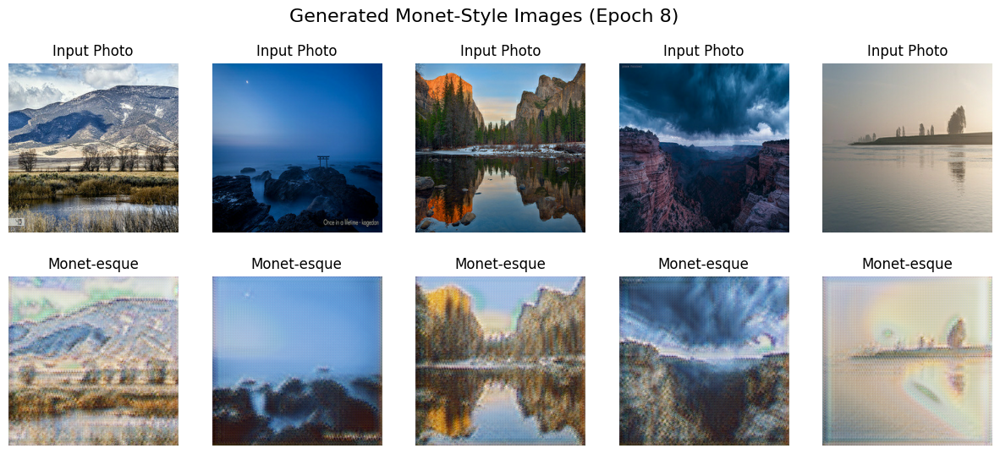

Epoch 9/20
Time for epoch 9: 127.72 seconds
Generator G Loss: 5.8824
Generator F Loss: 5.4880
Discriminator Monet Loss: 0.4101
Discriminator Photo Loss: 0.5050
Cycle Consistency Loss: 0.2836
Identity Loss: 0.2737
Generated images after 9 epochs:


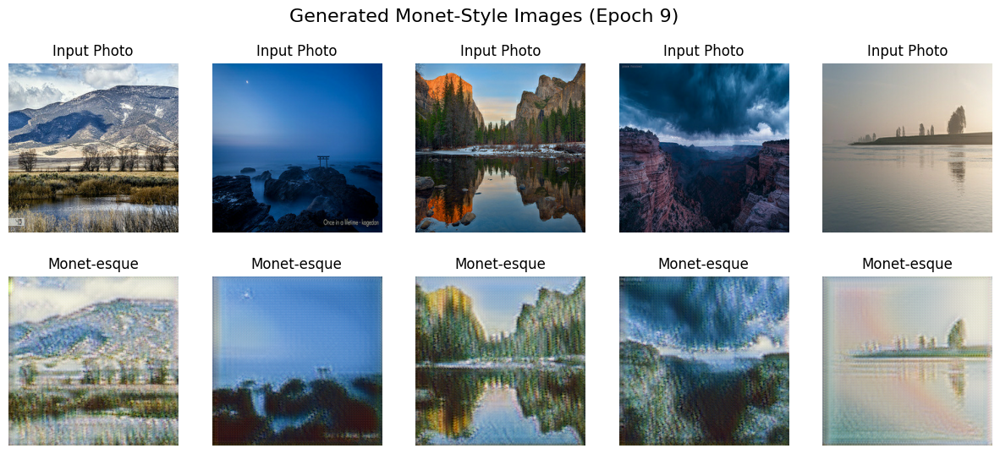

Epoch 10/20
Time for epoch 10: 127.68 seconds
Generator G Loss: 5.6092
Generator F Loss: 5.2873
Discriminator Monet Loss: 0.4404
Discriminator Photo Loss: 0.5065
Cycle Consistency Loss: 0.2687
Identity Loss: 0.2649
Generated images after 10 epochs:


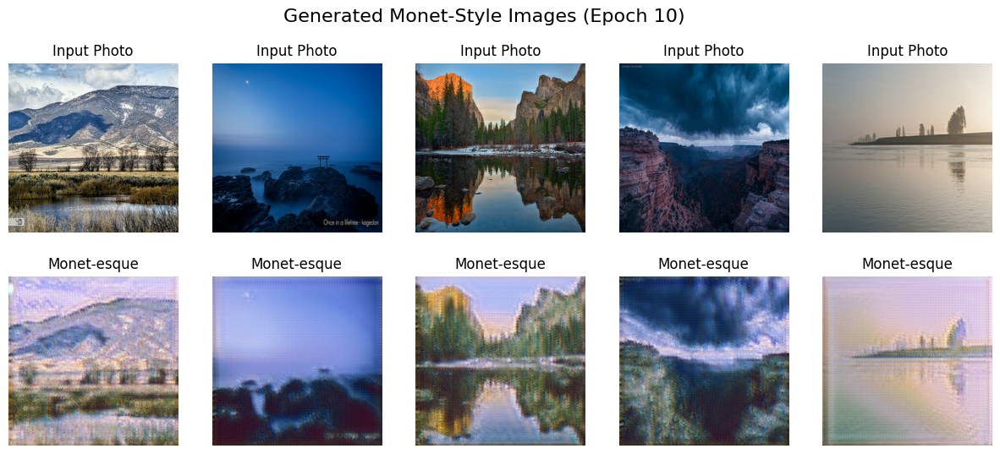

Epoch 11/20
Time for epoch 11: 127.61 seconds
Generator G Loss: 5.6748
Generator F Loss: 5.3417
Discriminator Monet Loss: 0.4387
Discriminator Photo Loss: 0.5002
Cycle Consistency Loss: 0.2685
Identity Loss: 0.2628
Generated images after 11 epochs:


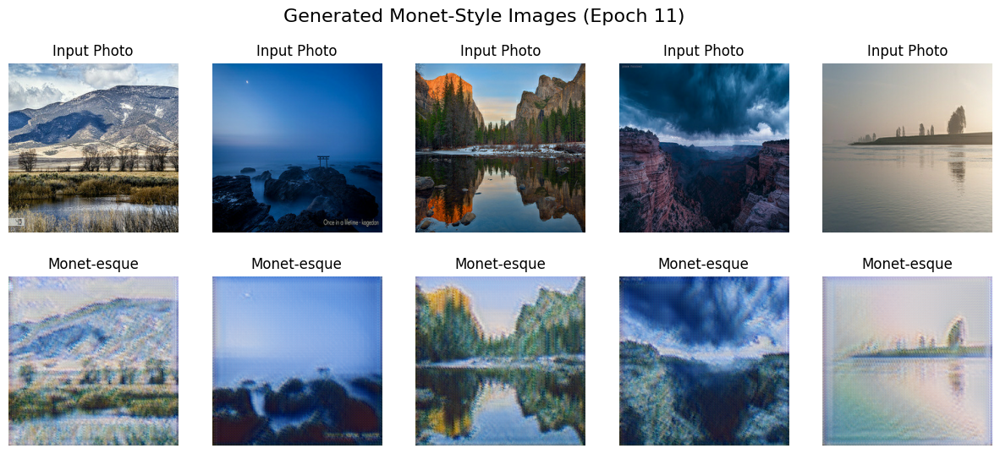

Epoch 12/20
Time for epoch 12: 127.64 seconds
Generator G Loss: 5.5988
Generator F Loss: 5.3572
Discriminator Monet Loss: 0.4369
Discriminator Photo Loss: 0.4800
Cycle Consistency Loss: 0.2681
Identity Loss: 0.2580
Generated images after 12 epochs:


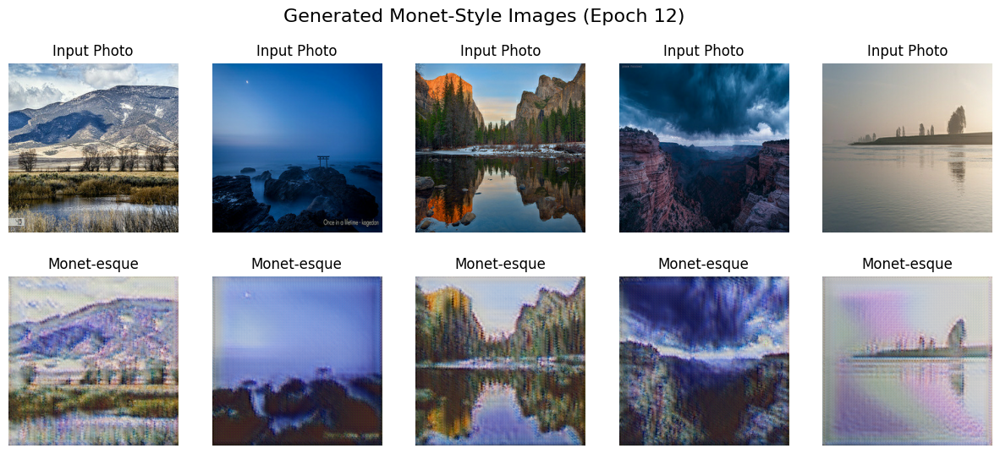

Epoch 13/20
Time for epoch 13: 127.82 seconds
Generator G Loss: 5.4153
Generator F Loss: 5.1708
Discriminator Monet Loss: 0.4610
Discriminator Photo Loss: 0.4978
Cycle Consistency Loss: 0.2570
Identity Loss: 0.2464
Generated images after 13 epochs:


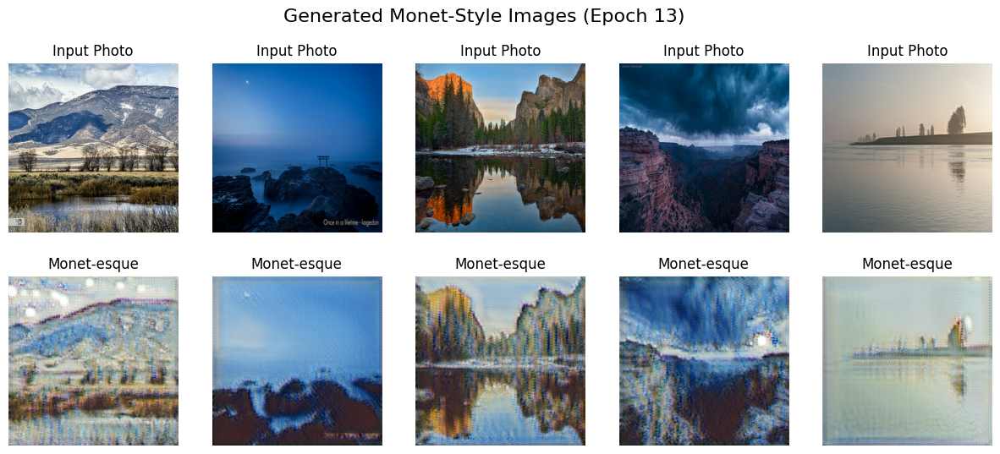

Epoch 14/20
Time for epoch 14: 127.79 seconds
Generator G Loss: 5.4609
Generator F Loss: 5.1273
Discriminator Monet Loss: 0.4309
Discriminator Photo Loss: 0.4941
Cycle Consistency Loss: 0.2516
Identity Loss: 0.2459
Generated images after 14 epochs:


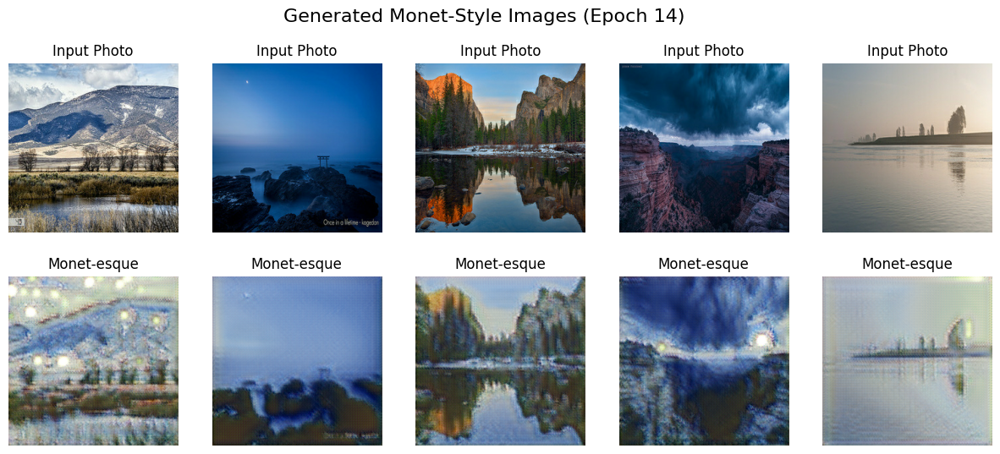

Epoch 15/20
Time for epoch 15: 127.70 seconds
Generator G Loss: 5.5456
Generator F Loss: 5.0582
Discriminator Monet Loss: 0.3847
Discriminator Photo Loss: 0.4875
Cycle Consistency Loss: 0.2480
Identity Loss: 0.2424
Generated images after 15 epochs:


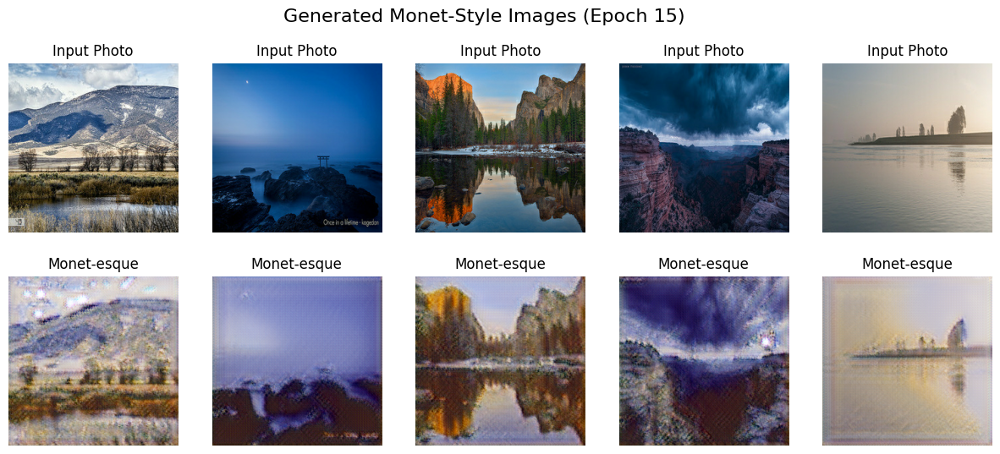

Epoch 16/20
Time for epoch 16: 127.72 seconds
Generator G Loss: 5.6757
Generator F Loss: 5.1628
Discriminator Monet Loss: 0.3620
Discriminator Photo Loss: 0.4741
Cycle Consistency Loss: 0.2479
Identity Loss: 0.2413
Generated images after 16 epochs:


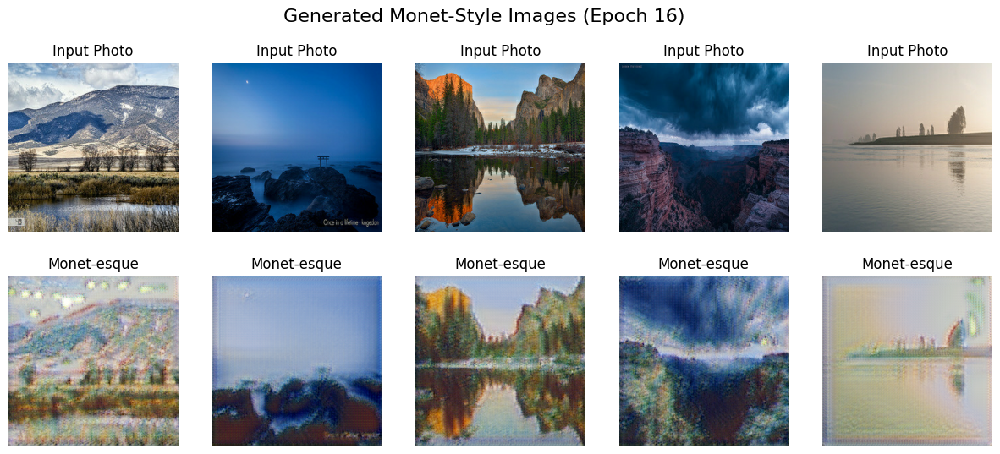

Epoch 17/20
Time for epoch 17: 127.73 seconds
Generator G Loss: 5.8066
Generator F Loss: 5.1610
Discriminator Monet Loss: 0.3467
Discriminator Photo Loss: 0.4429
Cycle Consistency Loss: 0.2445
Identity Loss: 0.2363
Generated images after 17 epochs:


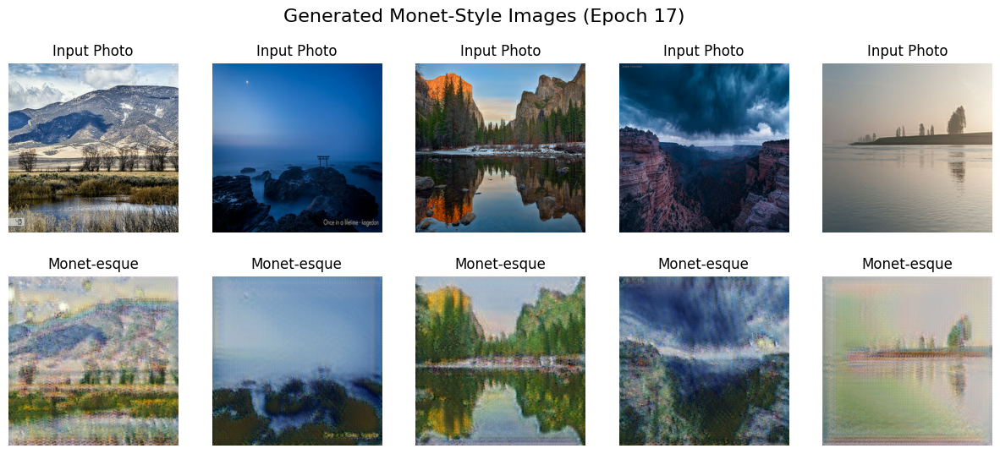

Epoch 18/20
Time for epoch 18: 127.69 seconds
Generator G Loss: 5.9981
Generator F Loss: 5.2383
Discriminator Monet Loss: 0.2947
Discriminator Photo Loss: 0.4327
Cycle Consistency Loss: 0.2422
Identity Loss: 0.2368
Generated images after 18 epochs:


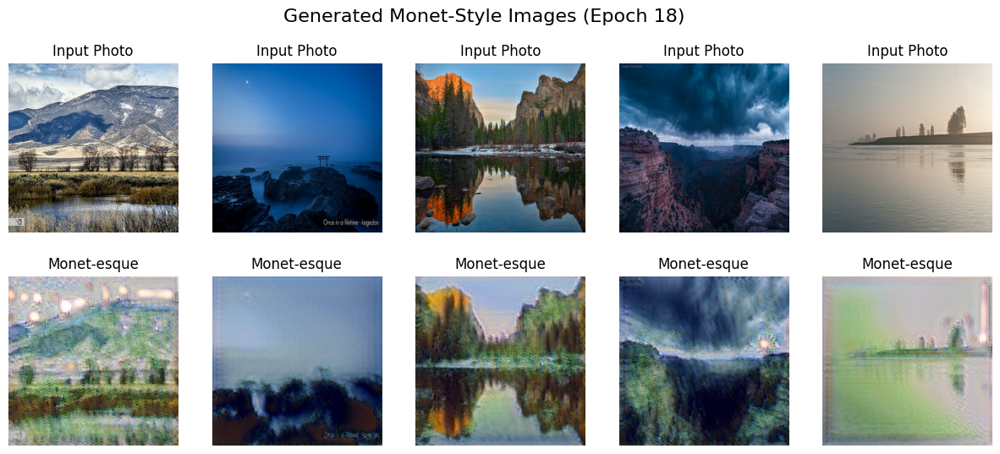

Epoch 19/20
Time for epoch 19: 128.16 seconds
Generator G Loss: 6.2264
Generator F Loss: 5.2219
Discriminator Monet Loss: 0.2614
Discriminator Photo Loss: 0.4127
Cycle Consistency Loss: 0.2346
Identity Loss: 0.2309
Generated images after 19 epochs:


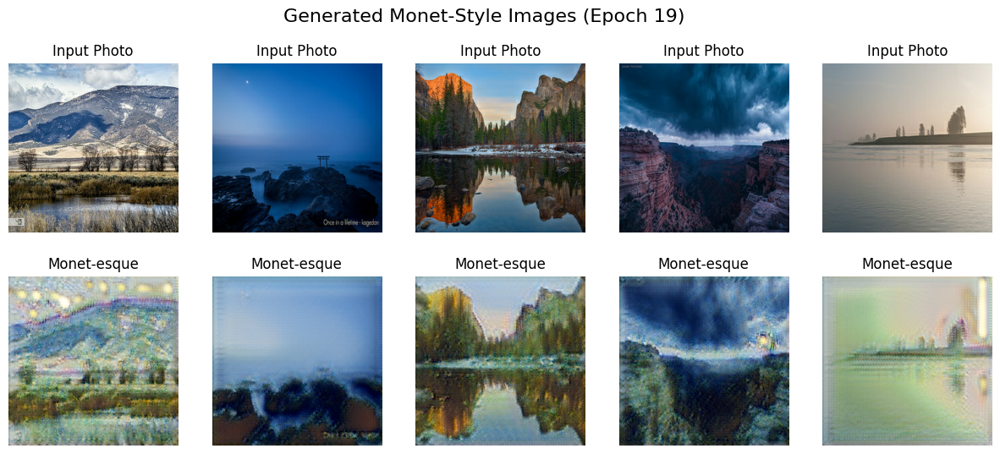

Epoch 20/20
Time for epoch 20: 128.37 seconds
Generator G Loss: 6.4885
Generator F Loss: 5.3357
Discriminator Monet Loss: 0.2292
Discriminator Photo Loss: 0.3869
Cycle Consistency Loss: 0.2333
Identity Loss: 0.2308
Generated images after 20 epochs:


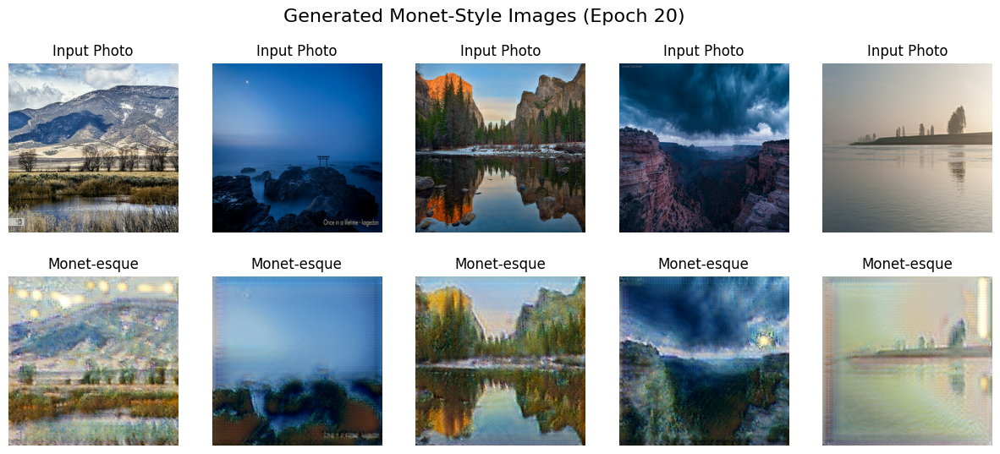

In [12]:
import time
from IPython.display import clear_output

# Hyperparameters
EPOCHS = 20
LEARNING_RATE = 0.0002  # Starting learning rate
BATCH_SIZE = 1          # Default for GANs
CYCLE_LOSS_WEIGHT = 10.0
IDENTITY_LOSS_WEIGHT = 5.0

# Calculate the number of batches
num_monet_images = sum(1 for _ in monet_dataset)
num_batches = num_monet_images // BATCH_SIZE

# Function to visualize generated images
def visualize_generated_images(generator, dataset, title, num_images=5):
    import matplotlib.pyplot as plt
    import numpy as np

    _, ax = plt.subplots(2, num_images, figsize=(15, 6))
    for i, img in enumerate(dataset.take(num_images)):
        # Expand dimensions to add batch axis
        img = tf.expand_dims(img, axis=0)  # Add batch dimension

        # Generate Monet-style image
        generated_image = generator(img, training=False).numpy()[0]  # Remove batch dimension

        # Display input and generated images
        ax[0, i].imshow(img[0])
        ax[1, i].imshow(generated_image)
        ax[0, i].set_title("Input Photo")
        ax[1, i].set_title("Monet-esque")
        ax[0, i].axis("off")
        ax[1, i].axis("off")

    plt.suptitle(title, fontsize=16)
    plt.show()

# Prepare datasets for training
monet_batches = monet_dataset.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)
photo_batches = photo_dataset.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)

# Learning rate decay
lr_schedule = tf.keras.optimizers.schedules.PolynomialDecay(
    initial_learning_rate=LEARNING_RATE,
    decay_steps=EPOCHS * num_batches,
    end_learning_rate=LEARNING_RATE * 0.1
)
generator_g_optimizer.learning_rate = lr_schedule
generator_f_optimizer.learning_rate = lr_schedule

# Training loop
def train_cycle_gan(epochs, monet_batches, photo_batches, log_interval=1):
    # Initialize logs
    gen_g_losses, gen_f_losses = [], []
    disc_m_losses, disc_p_losses = [], []
    cycle_losses, identity_losses = [], []
    
    for epoch in range(epochs):
        start_time = time.time()
        gen_g_loss_avg = tf.keras.metrics.Mean()
        gen_f_loss_avg = tf.keras.metrics.Mean()
        disc_m_loss_avg = tf.keras.metrics.Mean()
        disc_p_loss_avg = tf.keras.metrics.Mean()
        cycle_loss_avg = tf.keras.metrics.Mean()
        identity_loss_avg = tf.keras.metrics.Mean()
        
        print(f"Epoch {epoch + 1}/{epochs}")
        for real_photo, real_monet in tf.data.Dataset.zip((photo_batches, monet_batches)):
            # Run training step
            losses = train_step(real_photo, real_monet)
            
            # Update metrics
            gen_g_loss_avg.update_state(losses["gen_g_loss"])
            gen_f_loss_avg.update_state(losses["gen_f_loss"])
            disc_m_loss_avg.update_state(losses["disc_m_loss"])
            disc_p_loss_avg.update_state(losses["disc_p_loss"])
            cycle_loss_avg.update_state(losses["cycle_loss"])
            identity_loss_avg.update_state(losses["identity_loss"])
        
        # Log epoch losses
        gen_g_losses.append(gen_g_loss_avg.result().numpy())
        gen_f_losses.append(gen_f_loss_avg.result().numpy())
        disc_m_losses.append(disc_m_loss_avg.result().numpy())
        disc_p_losses.append(disc_p_loss_avg.result().numpy())
        cycle_losses.append(cycle_loss_avg.result().numpy())
        identity_losses.append(identity_loss_avg.result().numpy())
        
        # End-of-epoch logging
        print(f"Time for epoch {epoch + 1}: {time.time() - start_time:.2f} seconds")
        print(f"Generator G Loss: {gen_g_loss_avg.result():.4f}")
        print(f"Generator F Loss: {gen_f_loss_avg.result():.4f}")
        print(f"Discriminator Monet Loss: {disc_m_loss_avg.result():.4f}")
        print(f"Discriminator Photo Loss: {disc_p_loss_avg.result():.4f}")
        print(f"Cycle Consistency Loss: {cycle_loss_avg.result():.4f}")
        print(f"Identity Loss: {identity_loss_avg.result():.4f}")
        
        # Display generated images at regular intervals
        if (epoch + 1) % log_interval == 0:
            print(f"Generated images after {epoch + 1} epochs:")
            visualize_generated_images(generator_G, photo_dataset, f"Generated Monet-Style Images (Epoch {epoch + 1})", num_images=5)
    
    # Return collected metrics
    return {
        "gen_g_losses": gen_g_losses,
        "gen_f_losses": gen_f_losses,
        "disc_m_losses": disc_m_losses,
        "disc_p_losses": disc_p_losses,
        "cycle_losses": cycle_losses,
        "identity_losses": identity_losses,
    }


# Start training
# Train model version 1
results_v1 = train_cycle_gan(epochs=20, monet_batches=monet_batches, photo_batches=photo_batches)

In [13]:
# Save the trained generator models
generator_G.save('generator_G_v1.h5')  # For transforming photos to Monet-style
generator_F.save('generator_F_v1.h5')  # For transforming Monet to photos

# Save the discriminator models
discriminator_M.save('discriminator_M_v1.h5')  # Monet discriminator
discriminator_P.save('discriminator_P_v1.h5')  # Photo discriminator

## Hyperparameter Tuning

Next lets try to tune the hyperparameters further. Since we are decaying the learning rate already, it really doesn't make any sense to experiment with a  different starting learning rate, however from the above results, it seems like the generated images are over stylized and lack important details from the original photo. Therefore, for the next iteration lets try to increase the below two parameters to preserve more details in the generated images.

* Higher Cycle Loss Weight : 15.0
* Higher Identity Loss Weight: 10.0

Epoch 1/20
Time for epoch 1: 128.31 seconds
Generator G Loss: 6.6437
Generator F Loss: 5.4358
Discriminator Monet Loss: 0.2084
Discriminator Photo Loss: 0.3566
Cycle Consistency Loss: 0.2300
Identity Loss: 0.2257
Generated images after 1 epochs:


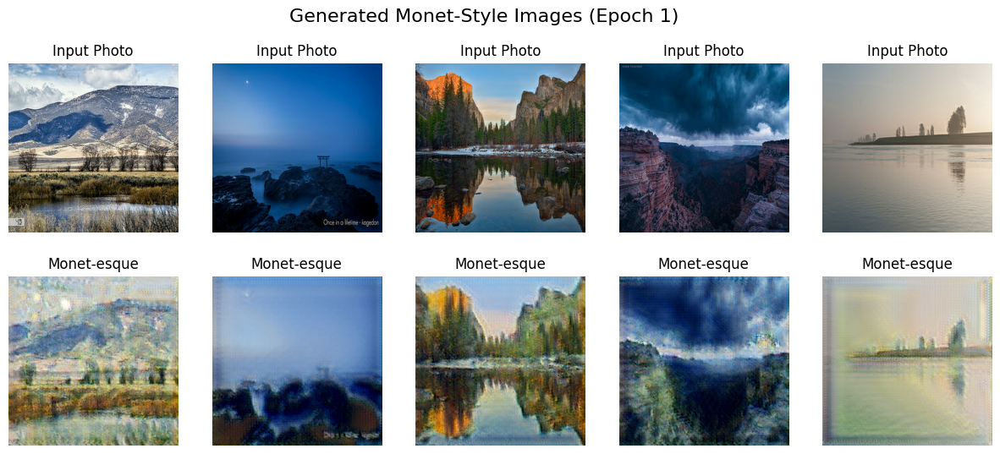

Epoch 2/20
Time for epoch 2: 128.34 seconds
Generator G Loss: 6.6691
Generator F Loss: 5.5762
Discriminator Monet Loss: 0.2006
Discriminator Photo Loss: 0.3184
Cycle Consistency Loss: 0.2297
Identity Loss: 0.2261
Generated images after 2 epochs:


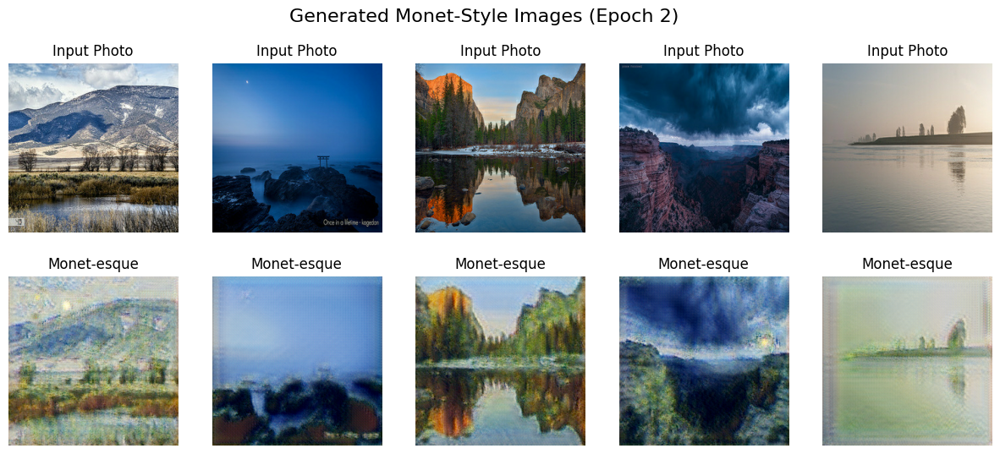

Epoch 3/20
Time for epoch 3: 128.25 seconds
Generator G Loss: 6.7752
Generator F Loss: 5.6601
Discriminator Monet Loss: 0.1800
Discriminator Photo Loss: 0.3126
Cycle Consistency Loss: 0.2278
Identity Loss: 0.2256
Generated images after 3 epochs:


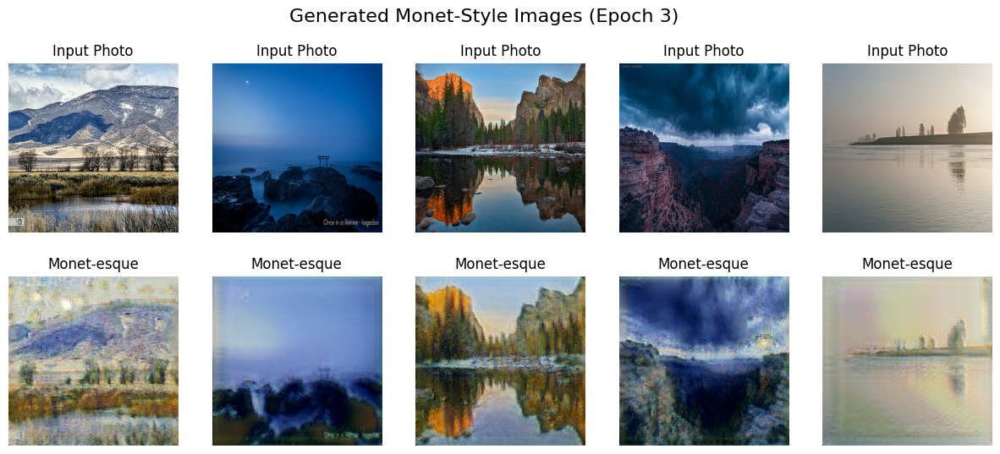

Epoch 4/20
Time for epoch 4: 128.38 seconds
Generator G Loss: 6.9596
Generator F Loss: 5.8173
Discriminator Monet Loss: 0.1976
Discriminator Photo Loss: 0.2869
Cycle Consistency Loss: 0.2297
Identity Loss: 0.2241
Generated images after 4 epochs:


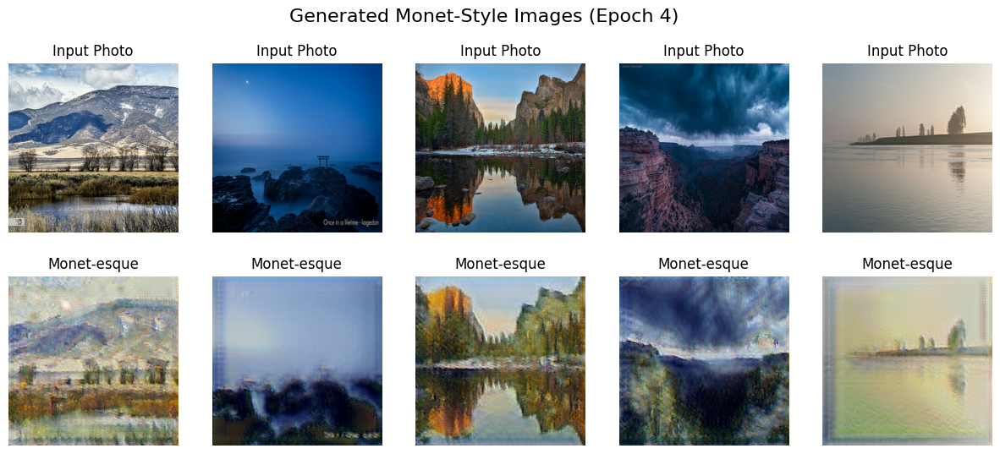

Epoch 5/20
Time for epoch 5: 128.19 seconds
Generator G Loss: 6.9463
Generator F Loss: 5.8126
Discriminator Monet Loss: 0.1584
Discriminator Photo Loss: 0.3061
Cycle Consistency Loss: 0.2269
Identity Loss: 0.2226
Generated images after 5 epochs:


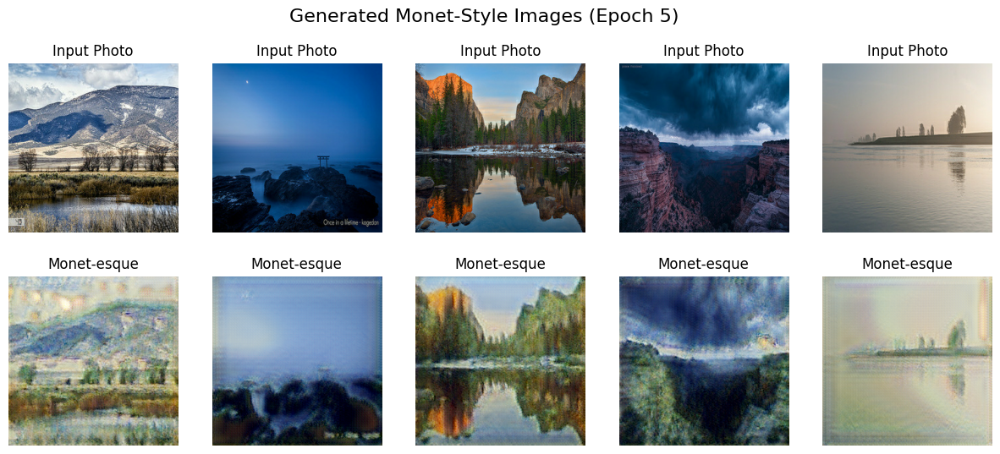

Epoch 6/20
Time for epoch 6: 128.32 seconds
Generator G Loss: 6.9309
Generator F Loss: 5.8517
Discriminator Monet Loss: 0.1578
Discriminator Photo Loss: 0.2850
Cycle Consistency Loss: 0.2232
Identity Loss: 0.2207
Generated images after 6 epochs:


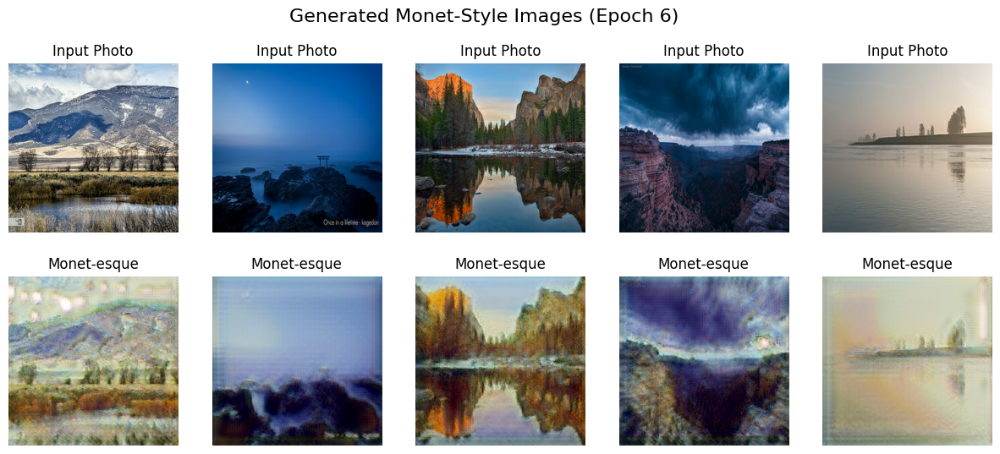

Epoch 7/20
Time for epoch 7: 128.39 seconds
Generator G Loss: 7.0062
Generator F Loss: 5.9616
Discriminator Monet Loss: 0.1755
Discriminator Photo Loss: 0.2617
Cycle Consistency Loss: 0.2255
Identity Loss: 0.2220
Generated images after 7 epochs:


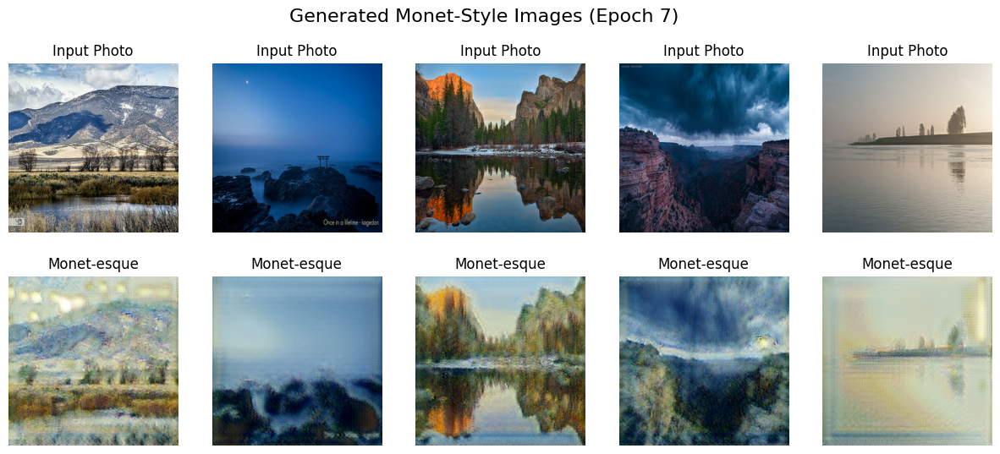

Epoch 8/20
Time for epoch 8: 128.30 seconds
Generator G Loss: 7.0212
Generator F Loss: 6.0279
Discriminator Monet Loss: 0.1338
Discriminator Photo Loss: 0.2730
Cycle Consistency Loss: 0.2221
Identity Loss: 0.2221
Generated images after 8 epochs:


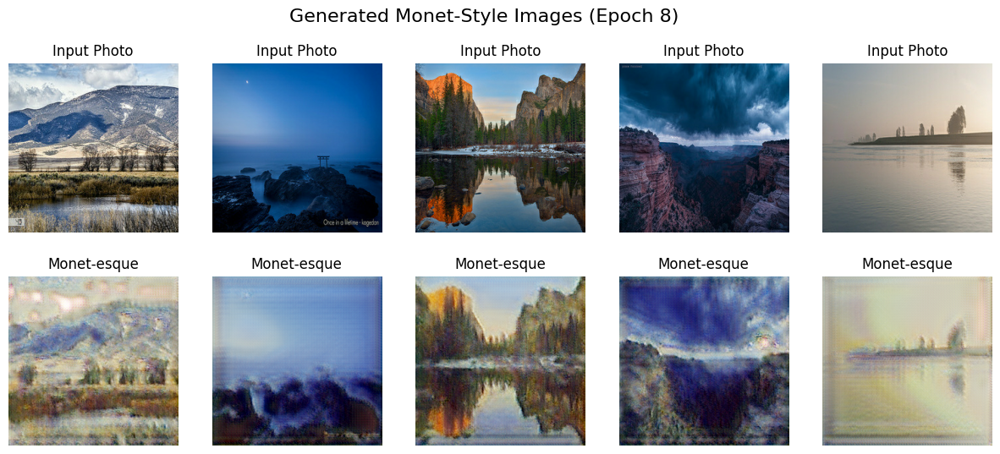

Epoch 9/20
Time for epoch 9: 128.20 seconds
Generator G Loss: 7.0180
Generator F Loss: 6.0905
Discriminator Monet Loss: 0.1643
Discriminator Photo Loss: 0.2520
Cycle Consistency Loss: 0.2264
Identity Loss: 0.2225
Generated images after 9 epochs:


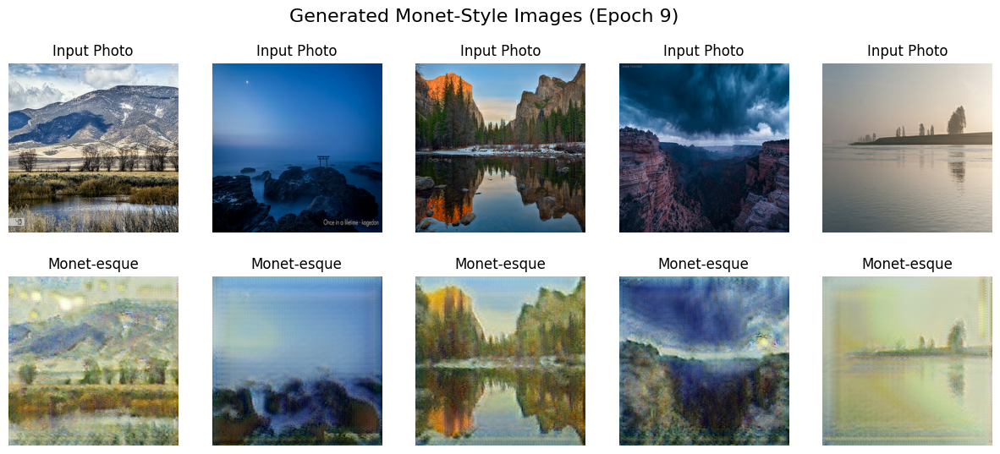

Epoch 10/20
Time for epoch 10: 128.35 seconds
Generator G Loss: 6.9104
Generator F Loss: 6.2754
Discriminator Monet Loss: 0.1682
Discriminator Photo Loss: 0.2209
Cycle Consistency Loss: 0.2254
Identity Loss: 0.2236
Generated images after 10 epochs:


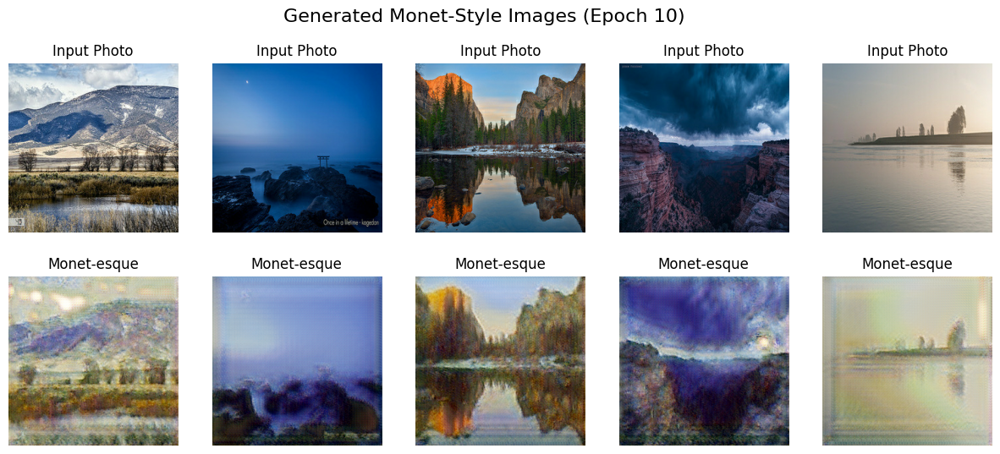

Epoch 11/20
Time for epoch 11: 128.08 seconds
Generator G Loss: 7.2621
Generator F Loss: 6.2764
Discriminator Monet Loss: 0.1148
Discriminator Photo Loss: 0.2428
Cycle Consistency Loss: 0.2243
Identity Loss: 0.2236
Generated images after 11 epochs:


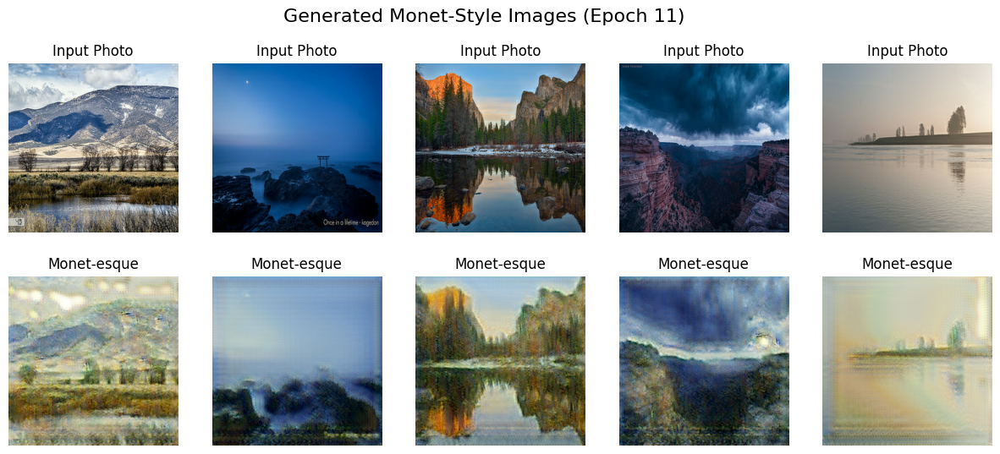

Epoch 12/20
Time for epoch 12: 128.15 seconds
Generator G Loss: 7.2254
Generator F Loss: 6.3379
Discriminator Monet Loss: 0.1350
Discriminator Photo Loss: 0.2286
Cycle Consistency Loss: 0.2230
Identity Loss: 0.2205
Generated images after 12 epochs:


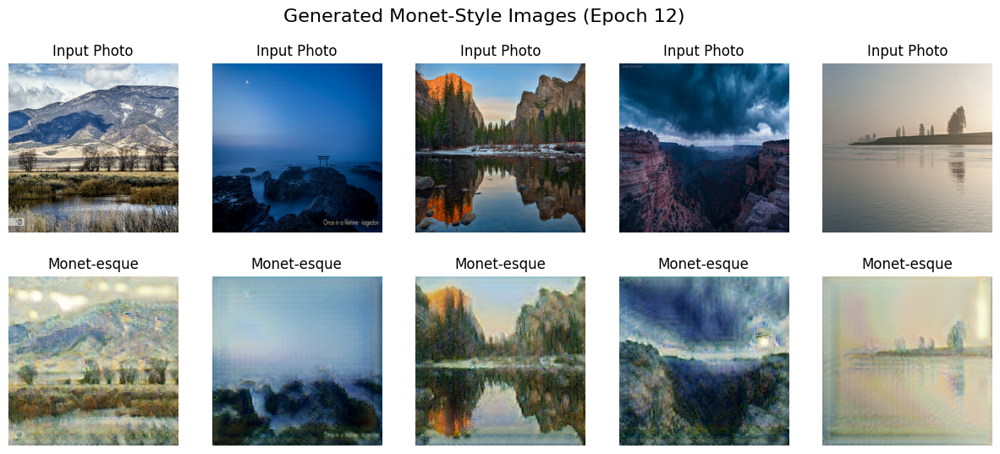

Epoch 13/20
Time for epoch 13: 128.15 seconds
Generator G Loss: 7.3158
Generator F Loss: 6.3272
Discriminator Monet Loss: 0.1566
Discriminator Photo Loss: 0.2570
Cycle Consistency Loss: 0.2235
Identity Loss: 0.2210
Generated images after 13 epochs:


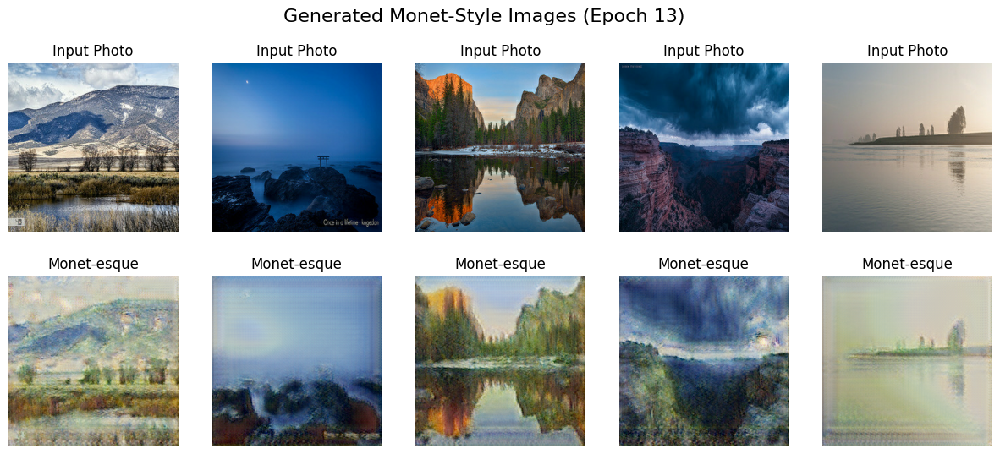

Epoch 14/20
Time for epoch 14: 128.18 seconds
Generator G Loss: 7.4191
Generator F Loss: 6.3504
Discriminator Monet Loss: 0.1370
Discriminator Photo Loss: 0.2192
Cycle Consistency Loss: 0.2250
Identity Loss: 0.2214
Generated images after 14 epochs:


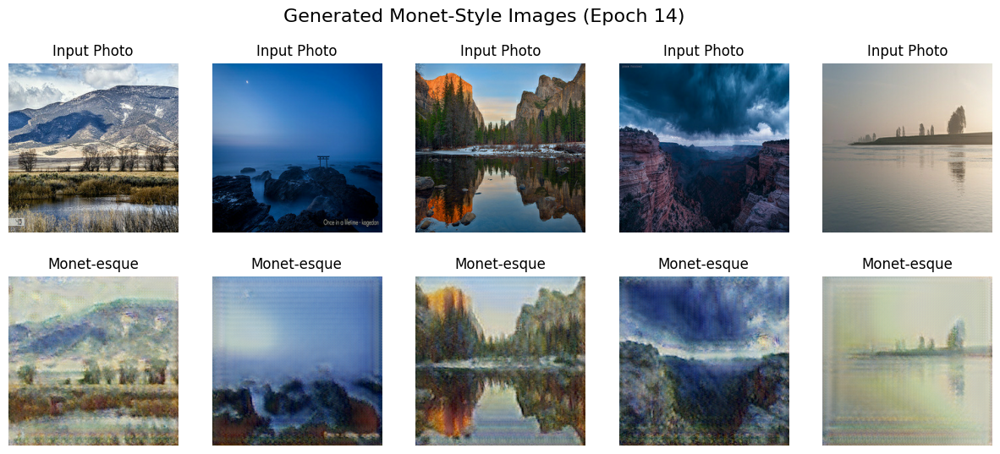

Epoch 15/20
Time for epoch 15: 128.24 seconds
Generator G Loss: 7.1835
Generator F Loss: 6.4952
Discriminator Monet Loss: 0.1849
Discriminator Photo Loss: 0.1817
Cycle Consistency Loss: 0.2227
Identity Loss: 0.2213
Generated images after 15 epochs:


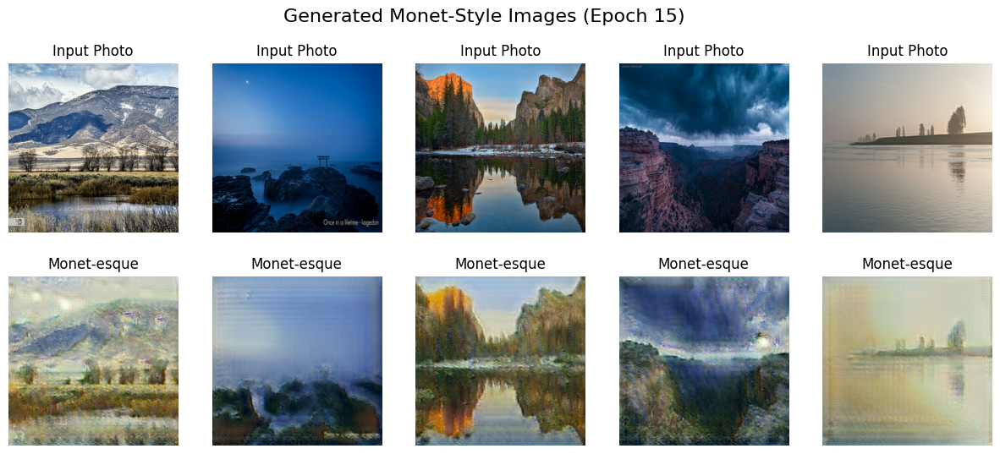

Epoch 16/20
Time for epoch 16: 128.27 seconds
Generator G Loss: 7.2888
Generator F Loss: 6.6024
Discriminator Monet Loss: 0.1481
Discriminator Photo Loss: 0.2226
Cycle Consistency Loss: 0.2230
Identity Loss: 0.2202
Generated images after 16 epochs:


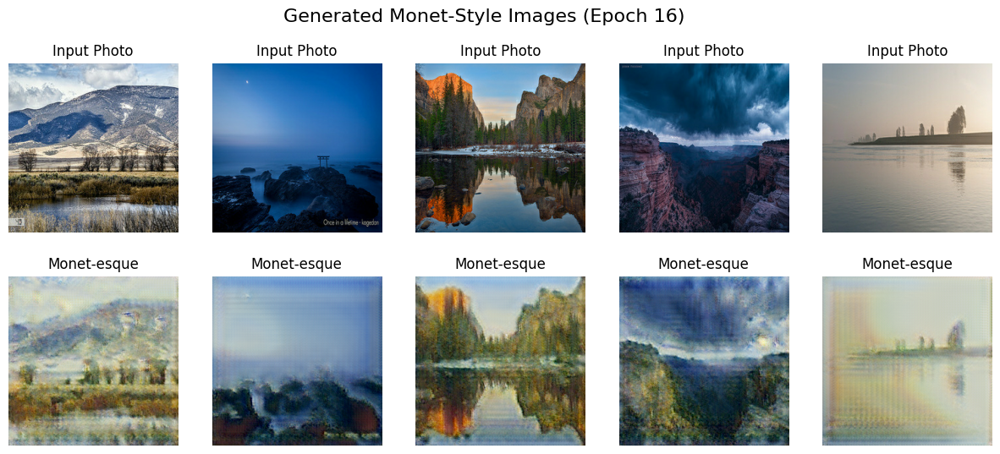

Epoch 17/20
Time for epoch 17: 128.18 seconds
Generator G Loss: 7.3403
Generator F Loss: 6.5058
Discriminator Monet Loss: 0.1729
Discriminator Photo Loss: 0.2017
Cycle Consistency Loss: 0.2231
Identity Loss: 0.2179
Generated images after 17 epochs:


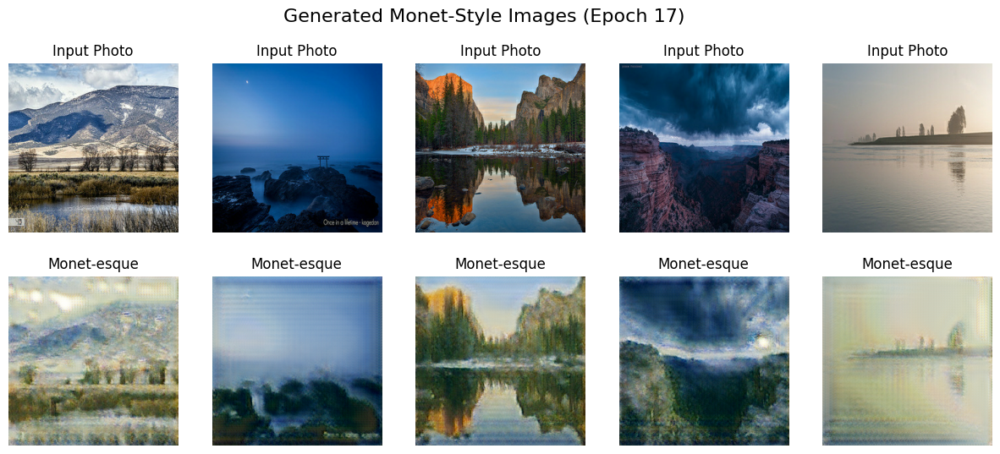

Epoch 18/20
Time for epoch 18: 128.14 seconds
Generator G Loss: 7.3650
Generator F Loss: 6.3126
Discriminator Monet Loss: 0.1551
Discriminator Photo Loss: 0.2708
Cycle Consistency Loss: 0.2212
Identity Loss: 0.2171
Generated images after 18 epochs:


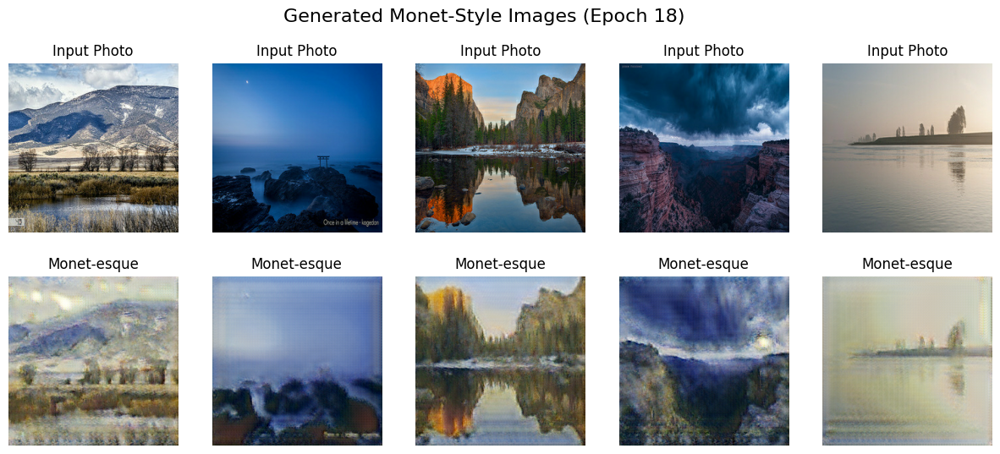

Epoch 19/20
Time for epoch 19: 128.35 seconds
Generator G Loss: 7.2870
Generator F Loss: 6.5121
Discriminator Monet Loss: 0.1379
Discriminator Photo Loss: 0.1861
Cycle Consistency Loss: 0.2226
Identity Loss: 0.2179
Generated images after 19 epochs:


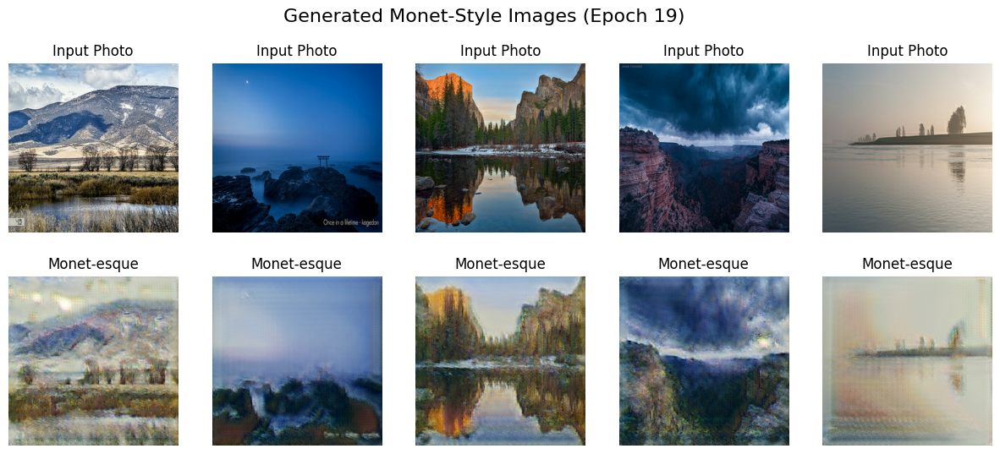

Epoch 20/20
Time for epoch 20: 128.28 seconds
Generator G Loss: 7.3075
Generator F Loss: 6.5077
Discriminator Monet Loss: 0.1557
Discriminator Photo Loss: 0.2140
Cycle Consistency Loss: 0.2211
Identity Loss: 0.2155
Generated images after 20 epochs:


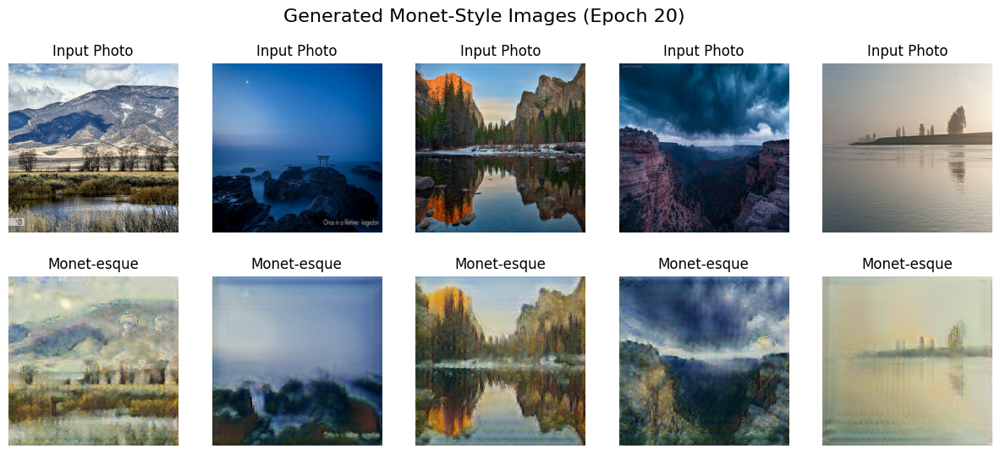

In [15]:
# Train Model Version 2 with adjusted loss weights
CYCLE_LOSS_WEIGHT = 15.0
IDENTITY_LOSS_WEIGHT = 10.0
results_v2 = train_cycle_gan(epochs=20, monet_batches=monet_batches, photo_batches=photo_batches)

In [16]:
# Save the trained generator models
generator_G.save('generator_G_v2.h5')  # For transforming photos to Monet-style
generator_F.save('generator_F_v2.h5')  # For transforming Monet to photos

# Save the discriminator models
discriminator_M.save('discriminator_M_v2.h5')  # Monet discriminator
discriminator_P.save('discriminator_P_v2.h5')  # Photo discriminator

## Comparison

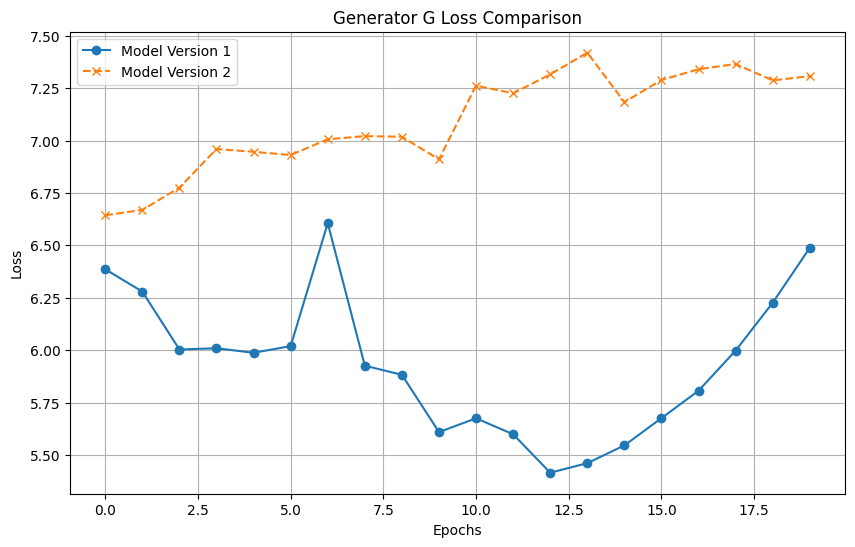

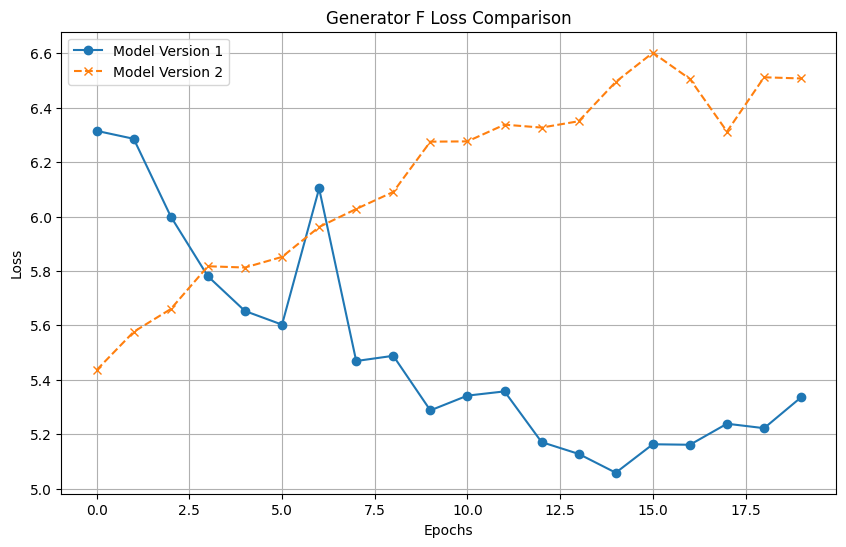

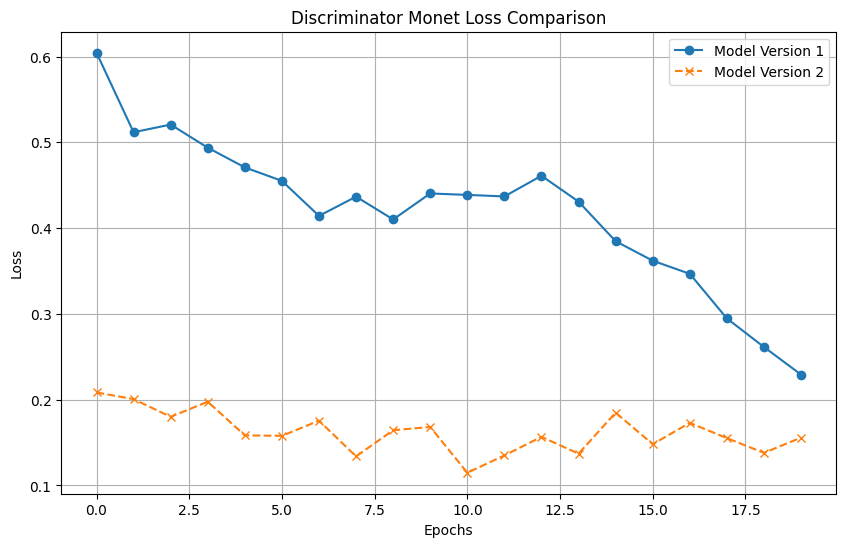

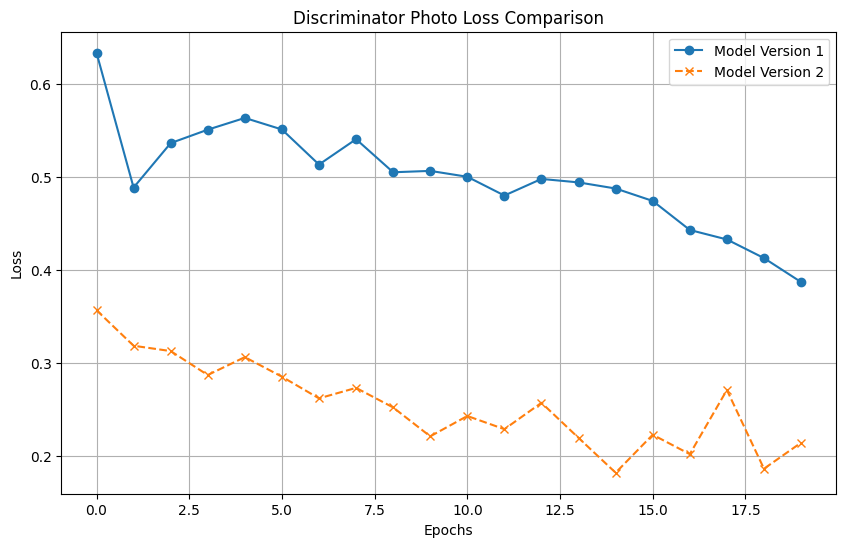

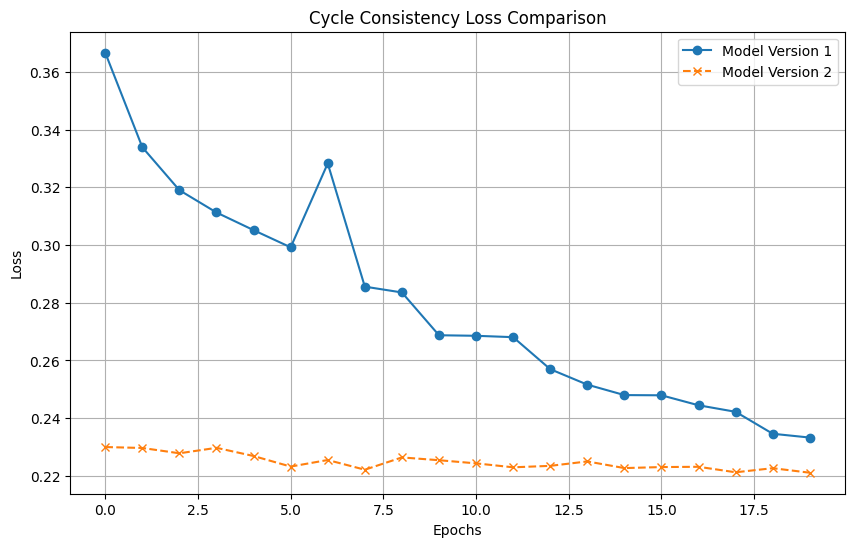

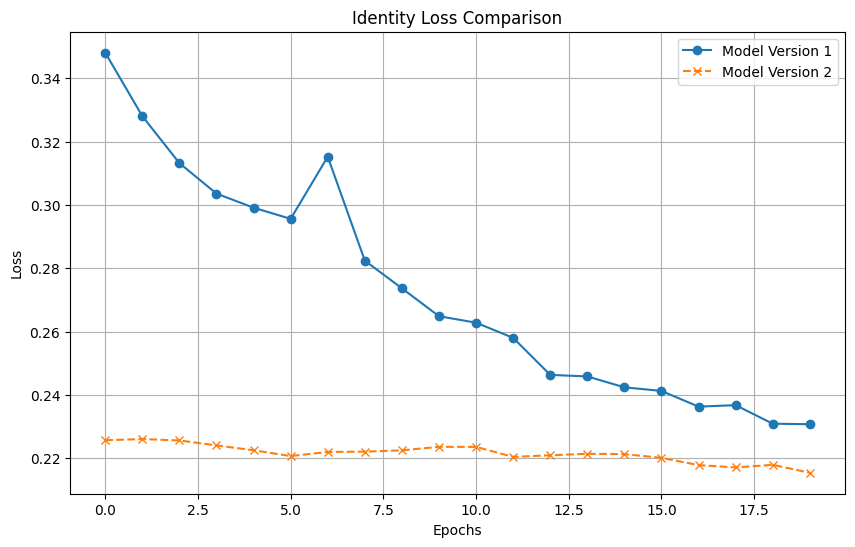

In [17]:
import matplotlib.pyplot as plt

def plot_metrics(results_v1, results_v2, metric_name, title, ylabel):
    plt.figure(figsize=(10, 6))
    plt.plot(results_v1[metric_name], label='Model Version 1', linestyle='-', marker='o')
    plt.plot(results_v2[metric_name], label='Model Version 2', linestyle='--', marker='x')
    plt.title(title)
    plt.xlabel('Epochs')
    plt.ylabel(ylabel)
    plt.legend()
    plt.grid()
    plt.show()

# Plot generator losses
plot_metrics(results_v1, results_v2, "gen_g_losses", "Generator G Loss Comparison", "Loss")
plot_metrics(results_v1, results_v2, "gen_f_losses", "Generator F Loss Comparison", "Loss")

# Plot discriminator losses
plot_metrics(results_v1, results_v2, "disc_m_losses", "Discriminator Monet Loss Comparison", "Loss")
plot_metrics(results_v1, results_v2, "disc_p_losses", "Discriminator Photo Loss Comparison", "Loss")

# Plot cycle consistency loss
plot_metrics(results_v1, results_v2, "cycle_losses", "Cycle Consistency Loss Comparison", "Loss")

# Plot identity loss
plot_metrics(results_v1, results_v2, "identity_losses", "Identity Loss Comparison", "Loss")

In [18]:
# Load the generator model v2
generator_G = tf.keras.models.load_model('generator_G_v2.h5', compile=False)
generator_F = tf.keras.models.load_model('generator_F_v2.h5', compile=False)

## Save Generated Images for Kaggle submission

In [21]:
from tqdm import tqdm
import shutil
from PIL import Image

def generate_and_save_images(generator, input_dataset, output_dir, num_images=7000):    
    os.makedirs(output_dir, exist_ok=True)  # Create output directory if it doesn't exist
    for i, photo in tqdm(enumerate(input_dataset.take(num_images)), total=num_images):
        # Add batch dimension and generate Monet-style image
        photo = tf.expand_dims(photo, axis=0)  # Shape: (1, 256, 256, 3)
        monet_image = generator(photo, training=False).numpy()[0]  # Remove batch dimension
        
        # Convert to uint8
        monet_image = np.clip(monet_image, 0, 255).astype('uint8')  # Ensure values are in [0, 255]
        
        # Save the generated image as a JPEG file
        file_path = os.path.join(output_dir, f'monet_image_{i + 1}.jpg')
        Image.fromarray(monet_image).save(file_path)


# Directory to save generated images
output_dir = './generated_monet_images'

# Generate Monet-style images
generate_and_save_images(generator_G, photo_dataset, output_dir, num_images=7000)


# Compress the generated images into images.zip
shutil.make_archive('images', 'zip', output_dir)

print("Submission file 'images.zip' has been created!")

100%|██████████| 7000/7000 [07:42<00:00, 15.13it/s]


Submission file 'images.zip' has been created!


# Alternative Architectures

## 1. StyleGAN
- **Overview**: StyleGAN excels at high-quality image generation by leveraging advanced style manipulation in the latent space.
- **Suitability for Monet Style Transfer**:
  - Can capture intricate artistic details like brush strokes and color blending.
  - Requires large datasets for training or fine-tuning.
- **Challenges**:
  - High computational requirements.
  - Does not inherently preserve the content structure of photos.

## 2. Pix2Pix
- **Overview**: Pix2Pix is designed for paired image-to-image translation using conditional GANs.
- **Suitability**:
  - Performs well for tasks where paired data is available (not the case here).
- **Challenges**:
  - Struggles with unpaired data unless cycle consistency loss is added.

## 3. U-GAT-IT
- **Overview**: U-GAT-IT is a GAN architecture designed for unpaired image-to-image translation with attention mechanisms.
- **Suitability**:
  - Attention maps help focus on key style attributes.
  - Better at transferring fine artistic details compared to CycleGAN.
- **Challenges**:
  - Higher complexity and training requirements.

## 4. VQ-VAE-2 (Vector Quantized Variational Autoencoder)
- **Overview**: VQ-VAE-2 is a generative model capable of producing high-quality images by learning a discrete latent space.
- **Suitability**:
  - Can model the artistic style of Monet paintings effectively.
- **Challenges**:
  - Requires careful tuning for specific artistic tasks.

---

## Conclusion on Alternatives
While **CycleGAN** performs well for this task, exploring architectures like **StyleGAN** or **U-GAT-IT** could yield more stylistically detailed results. For limited compute resources, CycleGAN remains the most practical choice.
